# Imports

In [101]:
import os
import pickle
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from darts import TimeSeries
from darts.dataprocessing import Pipeline
from darts.dataprocessing.transformers import Scaler
from darts.metrics import mae, mape, rmse
from darts.models import (
    FFT,
    AutoARIMA,
    ExponentialSmoothing,
    LightGBMModel,
    LinearRegressionModel,
    NaiveDrift,
    NaiveMean,
    NaiveMovingAverage,
    NaiveSeasonal,
    NBEATSModel,
    Prophet,
    RNNModel,
    Theta,
)
from darts.timeseries import concatenate
from darts.utils.missing_values import (
    extract_subseries,
    fill_missing_values,
    missing_values_ratio,
)
from darts.utils.model_selection import train_test_split
from pandas.plotting import register_matplotlib_converters
from pylab import rcParams
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import STL, seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from tqdm.auto import tqdm

In [102]:
# %matplotlib inline
warnings.filterwarnings("ignore")
# %config InlineBackend.figure_format='retina'

register_matplotlib_converters()
# sns.set(style='whitegrid', palette='muted', font_scale=1.5)
sns.set_theme()


rcParams["figure.figsize"] = 20, 5
# tqdm.pandas()

## Funções utilizadas

In [103]:
# Funções
def adf_test(series,title=''):
    """
    Pass in a time series and an optional title, returns an ADF report
    """
    print(f'Augmented Dickey-Fuller Test: {title}')
    result = adfuller(series.dropna(),autolag='AIC') # .dropna() handles differenced data
    
    labels = ['ADF test statistic','p-value','# lags used','# observations']
    out = pd.Series(result[0:4],index=labels)

    for key,val in result[4].items():
        out[f'critical value ({key})']=val
        
    print(out.to_string())          # .to_string() removes the line "dtype: float64"
    
    if result[1] <= 0.05:
        print("Strong evidence against the null hypothesis")
        print("Reject the null hypothesis")
        print("Data has no unit root and is stationary")
    else:
        print("Weak evidence against the null hypothesis")
        print("Fail to reject the null hypothesis")
        print("Data has a unit root and is non-stationary")

        

def train_process_timeseries(row, column_name, horizon=10):
    """
    Processes a single time series based on missing value criteria
    and splits it into subseries only if consecutive NaNs exceed a defined horizon.

    Args:
        row (pd.Series): Row from the DataFrame containing the data.
        column_name (str): Name of the metric column (e.g., 'RSRP').
        horizon (int): Minimum number of consecutive NaNs to define a significant gap.

    Returns:
        list[TimeSeries] | None: List of subseries or None if the series is discarded.
    """
    # Create TimeSeries with proper column name
    datetime_index = pd.to_datetime(row["Timestamp"])
    ts = TimeSeries.from_times_and_values(
        datetime_index,
        row[column_name],
        columns=[column_name],  # Renames the 'value' column
        freq="s"
    )

    # Compute missing value ratio
    ratio_missing = missing_values_ratio(ts)
    tqdm.write(f"[INFO] Missing ratio for {column_name}: {ratio_missing * 100:.2f}%")

    if ratio_missing > 0.4:
        tqdm.write(
            f"[INFO] Discarding series {column_name} for Uid {row['Uid']} (NaN > 40%)"
        )
        return None

    # Fill missing values
    ts = fill_missing_values(ts)

    # Split into subseries if gaps exceed the horizon
    subseries = extract_subseries(ts, min_gap_size=horizon, mode="any")

    if not subseries:
        tqdm.write(
            f"[WARNING] No valid subseries found for {column_name} (Uid {row['Uid']})"
        )
        return None

    return subseries


def split_by_uid_into_dfs(df: pd.DataFrame) -> list:
    """
    Splits a DataFrame with 'Timestamp' and 'RSRP' columns containing lists
    into a list of DataFrames, one for each Uid, with 'Timestamp' as the index.

    Parameters:
        df (pd.DataFrame): Original DataFrame with columns 'Uid', 'Timestamp', 'RSRP' (as lists).

    Returns:
        list_of_dfs (list): List of DataFrames (one for each Uid),
                            with 'Timestamp' as the index and 'RSRP' as the column.
    """
    # Explode list columns
    df_exploded = df[['Uid', 'Timestamp', 'RSRP']].explode(['Timestamp', 'RSRP'])

    # Ensure Timestamp is in datetime format
    df_exploded['Timestamp'] = pd.to_datetime(df_exploded['Timestamp'])

    # Create one DataFrame per Uid with Timestamp as index
    list_of_dfs = [
        group.set_index('Timestamp')[['RSRP']].sort_index()
        for _, group in df_exploded.groupby('Uid')
    ]

    return list_of_dfs

def detect_periodicity_fft(series, plot=True):
    """
    Detects the dominant periodicity of a time series using FFT.
    
    Parameters:
    - series: Darts TimeSeries object
    - plot: bool, if True, plots the frequency spectrum
    
    Returns:
    - dominant_freq: dominant frequency
    - dominant_period: dominant period (in number of points)
    """
    y = series.values().flatten()
    
    fft_vals = np.fft.fft(y - np.mean(y))
    freqs = np.fft.fftfreq(len(y))
    
    positive_freqs = freqs[freqs > 0]
    positive_fft = np.abs(fft_vals[freqs > 0])
    
    dominant_freq = positive_freqs[np.argmax(positive_fft)]
    dominant_period = 1 / dominant_freq

    print(f"Dominant frequency: {dominant_freq}")
    print(f"Estimated period: {dominant_period:.1f} points")

    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(positive_freqs, positive_fft)
        plt.title("Frequency Spectrum (FFT)")
        plt.xlabel("Frequency")
        plt.ylabel("Amplitude")
        plt.grid(True)
        plt.show()
        
    return dominant_freq, dominant_period

def plot_rsrp_distribution(df):
    # Flatten os valores de RSRP em uma única lista
    rsrp_all = [val for sublist in df["RSRP"] for val in sublist if val is not None]

    # Categorias conforme a tabela fornecida
    bins = [-140, -100, -90, -80, 0]  # limites de categorias
    colors = ['red', 'orange', 'yellow', 'green']
    labels = ['Cell Edge', 'Mid Cell', 'Good', 'Excellent']

    # Criar histograma
    n, bins, patches = plt.hist(rsrp_all, bins=bins, edgecolor='black')

    # Aplicar cores às barras
    for patch, color in zip(patches, colors):
        patch.set_facecolor(color)

    # Adicionar legenda
    handles = [plt.Rectangle((0, 0), 1, 1, color=color) for color in colors]
    plt.legend(handles, labels)

    # Título e rótulos
    plt.title('Distribuição de RSRP por Categoria de Qualidade de Sinal')
    plt.xlabel('RSRP (dBm)')
    plt.ylabel('Frequência')
    plt.grid(True)
    plt.show()

def plot_splits_by_uid(df):
    # Divide o DataFrame em múltiplos DataFrames baseados no UID
    list_of_splits = split_by_uid_into_dfs(df)
    
    # Plota cada DataFrame resultante
    for idx, split in enumerate(list_of_splits):
        plt.figure(figsize=(10, 6))
        split.plot(title=f'Série {idx}')
        plt.xlabel('Índice')
        plt.ylabel('Valor')
        plt.grid()
        plt.show()


## Dataset: Static Vs. Driving

In [160]:
# Montando o dicionário com os caminhos dos arquivos
data_directory = os.path.join(os.pardir, "data", "reduced_metrics_datasets")

file_dict = {
    "static_down_metrics": os.path.join(data_directory, "static_down_metrics.pkl"),
    "static_strm_metrics": os.path.join(data_directory, "static_strm_metrics.pkl"),
    "driving_down_metrics": os.path.join(data_directory, "driving_down_metrics.pkl"),
    "driving_strm_metrics": os.path.join(data_directory, "driving_strm_metrics.pkl"),
}

### Static Downloading

In [161]:
# Exemplo de como carregar o DataFrame
path = file_dict["static_down_metrics"]
with open(path, "rb") as f:
    df = pickle.load(f)

In [105]:
df

,Uid,Timestamp,RSRP,RSRQ,SNR,CQI,RSSI
0,9djwdBBd,"[2020-02-14 13:21:26, 2020-02-14 13:21:27, 202...","[-103.0, -103.0, -102.0, -103.0, -103.0, -104....","[-15.0, -15.0, -15.0, -16.0, -16.0, -16.0, -16...","[5.0, 5.0, 1.0, -2.0, -2.0, 2.0, 2.0, -4.0, -4...","[12.0, 12.0, 12.0, 10.0, 10.0, 9.0, 9.0, 6.0, ...","[-107.0, -107.0, -107.0, -105.0, -109.0, -105...."
1,LCQUcRoG,"[2020-01-16 10:43:34, 2020-01-16 10:43:35, 202...","[-99.0, -100.0, -100.0, -101.0, -101.0, -100.0...","[-10.0, -10.0, -10.0, -9.0, -9.0, -9.0, -9.0, ...","[9.0, 4.0, 4.0, 2.0, 2.0, 7.0, 7.0, 5.0, 5.0, ...","[14.0, 12.0, 12.0, 10.0, 10.0, 9.0, 9.0, 14.0,...","[-107.0, -107.0, -105.0, -105.0, -105.0, -105...."
2,VxjSDC9y,"[2019-12-16 13:40:04, 2019-12-16 13:40:05, 201...","[-103.0, -102.0, -102.0, -104.0, -104.0, -104....","[-15.0, -16.0, -16.0, -14.0, -14.0, -14.0, -14...","[1.0, 7.0, 7.0, -7.0, -7.0, -7.0, 1.0, -3.0, -...","[15.0, 15.0, 15.0, 11.0, 11.0, 11.0, 11.0, 11....","[-90.0, -90.0, -90.0, -88.0, -88.0, -88.0, -88..."
3,fqSn97mt,"[2020-02-27 18:39:27, 2020-02-27 18:39:28, 202...","[-101.0, -101.0, -101.0, -101.0, -101.0, -101....","[-10.0, -10.0, -10.0, -10.0, -12.0, -12.0, -10...","[0.0, 0.0, 8.0, 8.0, 3.0, 3.0, 4.0, 4.0, 8.0, ...","[12.0, 12.0, 13.0, 13.0, 12.0, 12.0, 12.0, 12....","[-103.0, -103.0, -103.0, -103.0, -103.0, -101...."
4,iNtHAz5B,"[2020-02-13 13:57:29, 2020-02-13 13:57:30, 202...","[-101.0, -101.0, -102.0, -102.0, -102.0, -100....","[-15.0, -12.0, -11.0, -11.0, -11.0, -12.0, -12...","[4.0, 1.0, 1.0, 1.0, 1.0, -4.0, -4.0, -5.0, -5...","[11.0, 9.0, 9.0, 9.0, 9.0, 11.0, 11.0, 10.0, 1...","[-103.0, -103.0, -103.0, -103.0, -103.0, -103...."


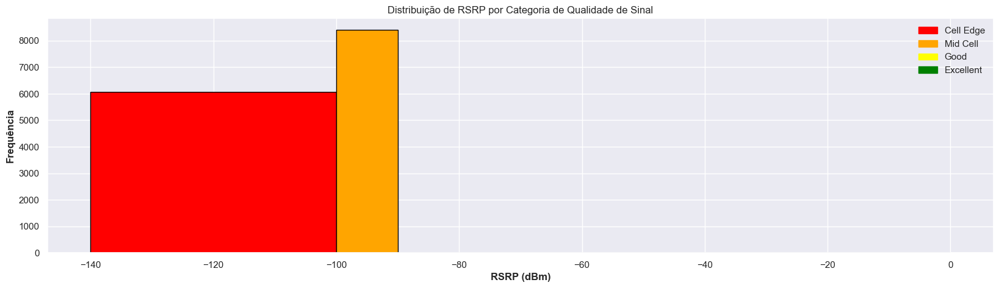

In [106]:
plot_rsrp_distribution(df)

<Figure size 1000x600 with 0 Axes>

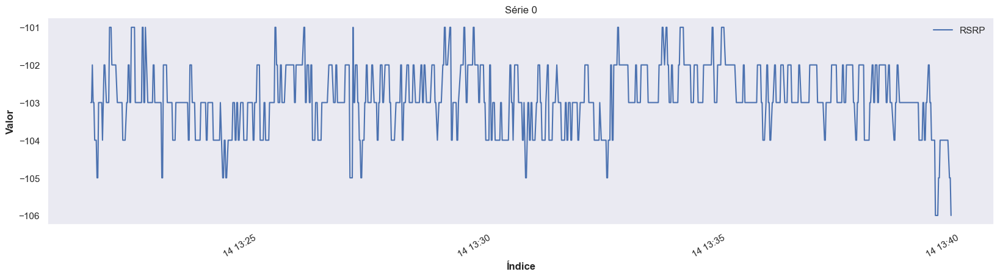

<Figure size 1000x600 with 0 Axes>

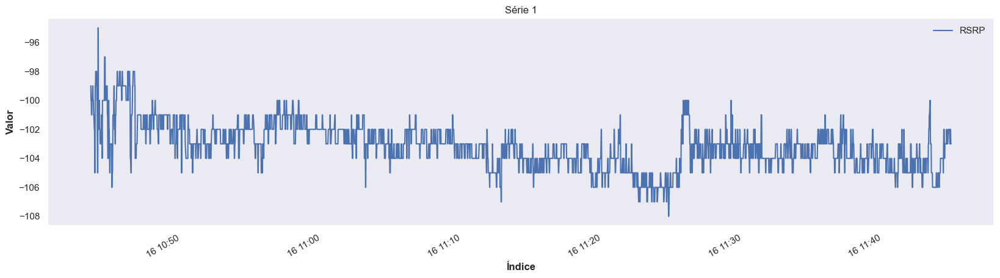

<Figure size 1000x600 with 0 Axes>

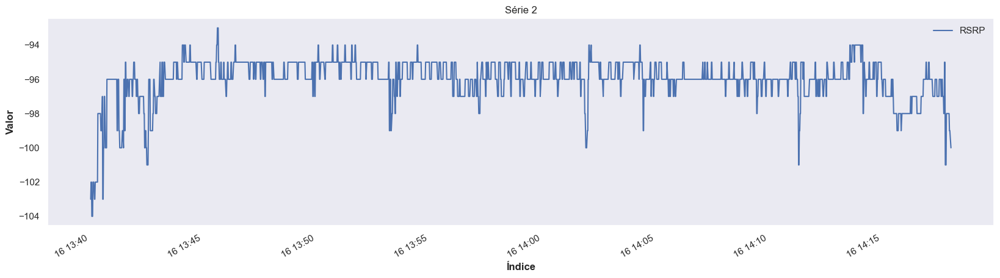

<Figure size 1000x600 with 0 Axes>

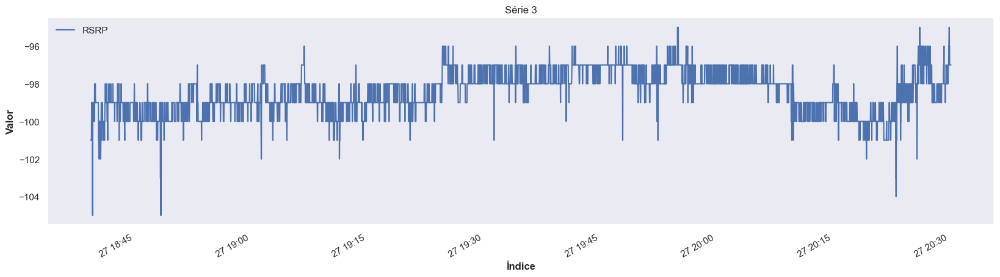

<Figure size 1000x600 with 0 Axes>

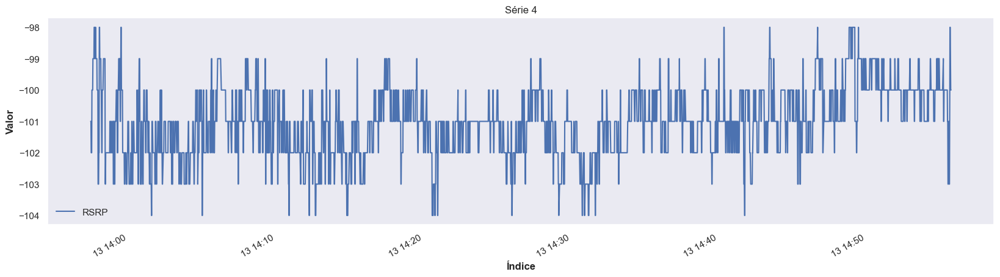

In [107]:
# Plot Raw Pandas
plot_splits_by_uid(df)

### Static Streaming

In [108]:
path = os.path.join(
    os.pardir, "data", "reduced_metrics_datasets", "static_strm_metrics.pkl"
)

with open(path, "rb") as f:
    df = pickle.load(f)

In [109]:
df.head(5)

,Uid,Timestamp,RSRP,RSRQ,SNR,CQI,RSSI
0,2ekc6zeM,"[2019-11-23 14:30:10, 2019-11-23 14:30:11, 201...","[-97.0, -94.0, -94.0, -96.0, -96.0, -95.0, -95...","[-12.0, -13.0, -13.0, -13.0, -13.0, -14.0, -14...","[10.0, 8.0, 8.0, 4.0, 4.0, 9.0, 9.0, 7.0, 7.0,...","[13.0, 11.0, 11.0, 11.0, 11.0, 11.0, 11.0, 11....","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ..."
1,AacErssH,"[2019-12-03 08:02:06, 2019-12-03 08:02:08, 201...","[-79.0, -80.0, -80.0, -79.0, -79.0, -80.0, -80...","[-9.0, -10.0, -10.0, -9.0, -9.0, -9.0, -9.0, -...","[4.0, 0.0, 0.0, 0.0, 0.0, 4.0, 4.0, 3.0, 3.0, ...","[15.0, 15.0, 15.0, 15.0, 8.0, 8.0, 10.0, 10.0,...","[-72.0, -72.0, -72.0, -72.0, -70.0, -70.0, -72..."
2,F5fDKH2Y,"[2019-11-28 09:21:45, 2019-11-28 09:21:46, 201...","[-88.0, -88.0, -89.0, -89.0, -87.0, -87.0, -87...","[-14.0, -14.0, -14.0, -14.0, -13.0, -13.0, -14...","[-3.0, -3.0, -1.0, -1.0, -3.0, -3.0, -4.0, -4....","[8.0, 8.0, 5.0, 5.0, 4.0, 4.0, 4.0, 4.0, 4.0, ...","[-70.0, -70.0, -72.0, -72.0, -70.0, -70.0, -70..."
3,GiCWc23X,"[2019-12-06 09:55:13, 2019-12-06 09:55:14, 201...","[-104.0, -103.0, -102.0, -102.0, -104.0, -104....","[-11.0, -10.0, -11.0, -11.0, -10.0, -10.0, -15...","[4.0, 11.0, 2.0, 2.0, 5.0, 5.0, -2.0, -2.0, 2....","[14.0, 14.0, 14.0, 14.0, 14.0, 14.0, 14.0, 14....","[-86.0, -86.0, -86.0, -86.0, -86.0, -86.0, -86..."
4,KtMyzAHC,"[2020-01-06 11:08:12, 2020-01-06 11:08:13, 202...","[-98.0, -99.0, -102.0, -102.0, -97.0, -97.0, -...","[-14.0, -14.0, -10.0, -10.0, -10.0, -10.0, -11...","[12.0, 9.0, 5.0, 5.0, 14.0, 14.0, -7.0, -7.0, ...","[11.0, 12.0, 13.0, 13.0, 14.0, 14.0, 14.0, 14....","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ..."


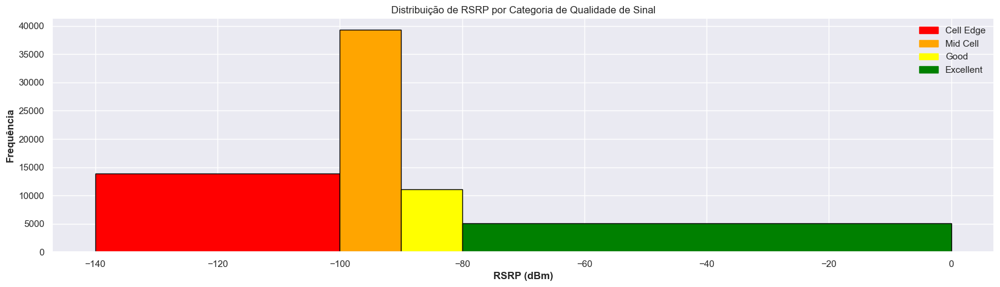

In [110]:
plot_rsrp_distribution(df)

<Figure size 1000x600 with 0 Axes>

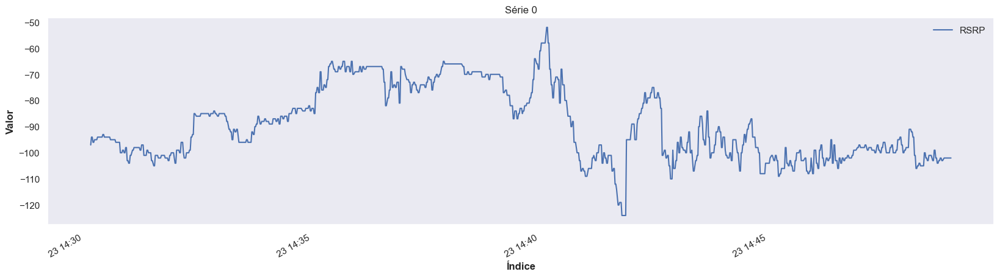

<Figure size 1000x600 with 0 Axes>

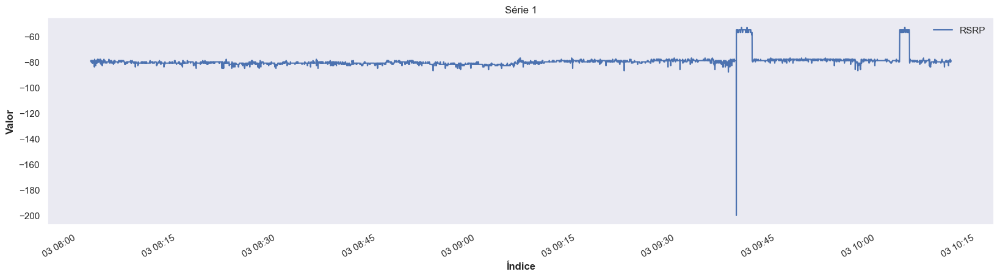

<Figure size 1000x600 with 0 Axes>

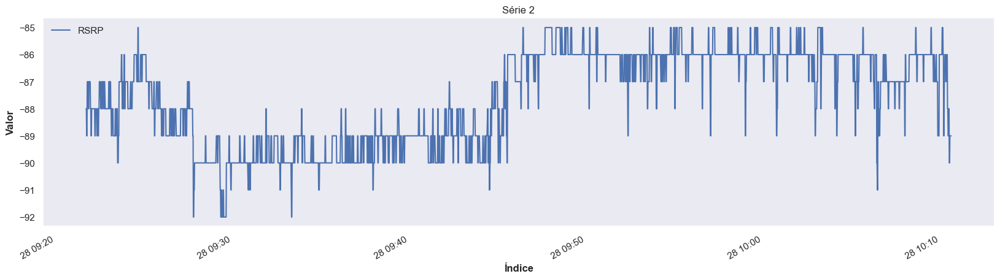

<Figure size 1000x600 with 0 Axes>

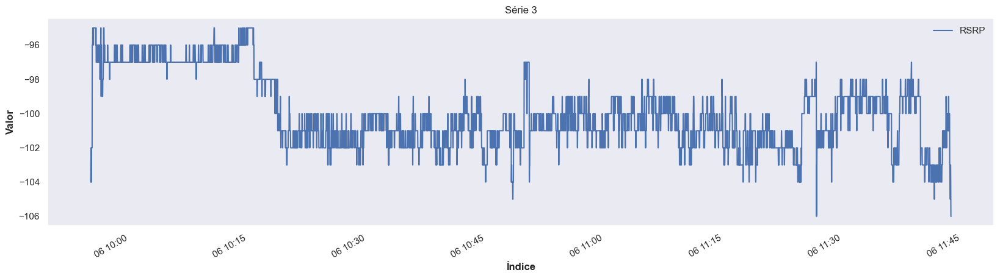

<Figure size 1000x600 with 0 Axes>

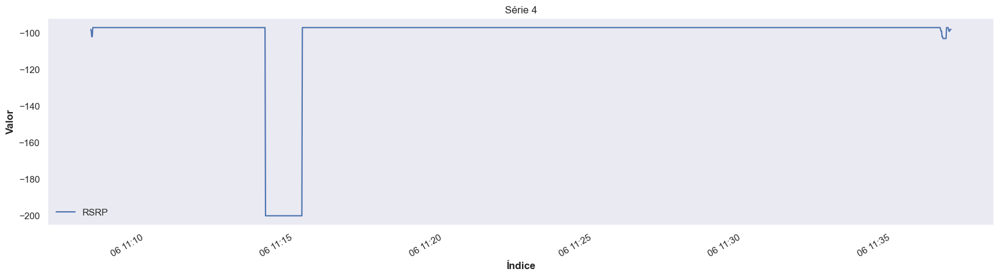

<Figure size 1000x600 with 0 Axes>

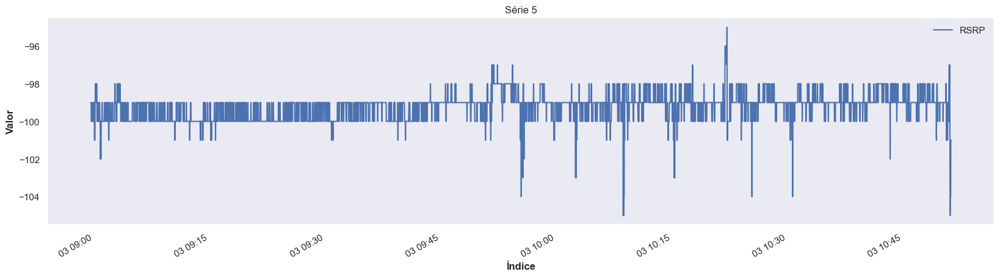

<Figure size 1000x600 with 0 Axes>

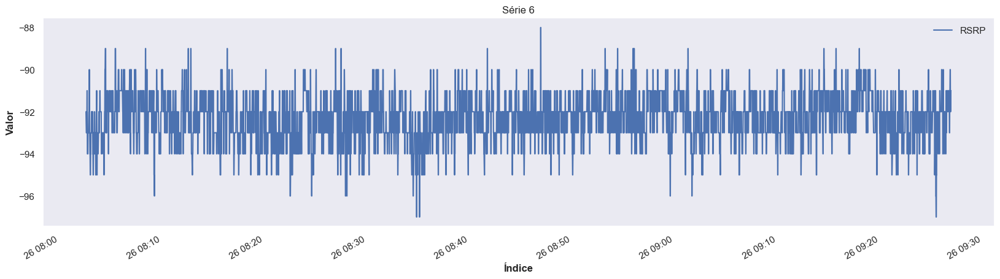

<Figure size 1000x600 with 0 Axes>

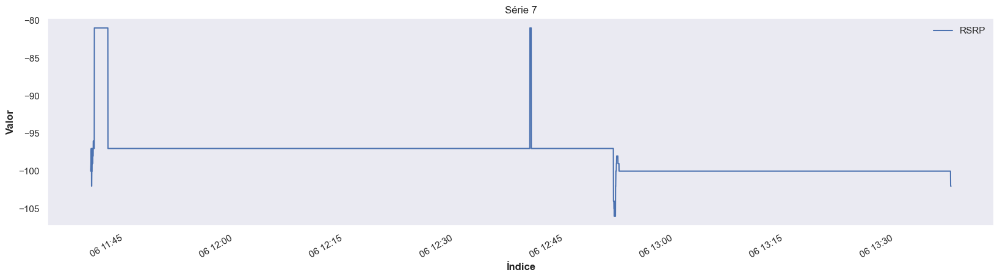

<Figure size 1000x600 with 0 Axes>

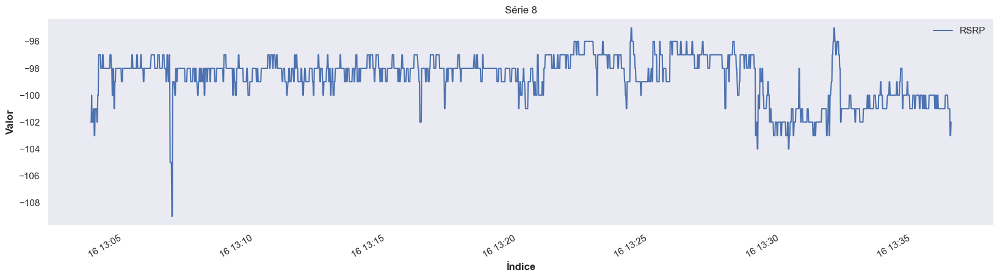

<Figure size 1000x600 with 0 Axes>

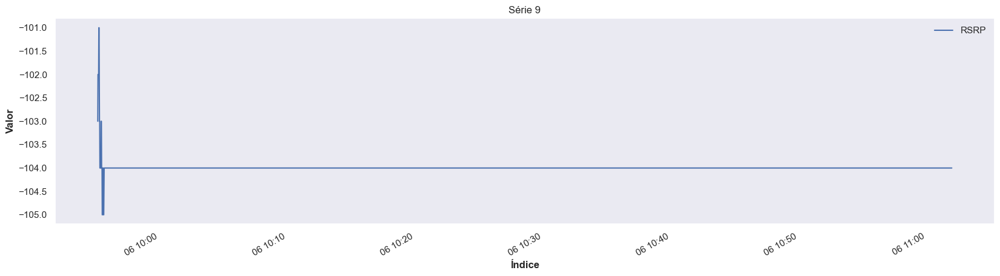

<Figure size 1000x600 with 0 Axes>

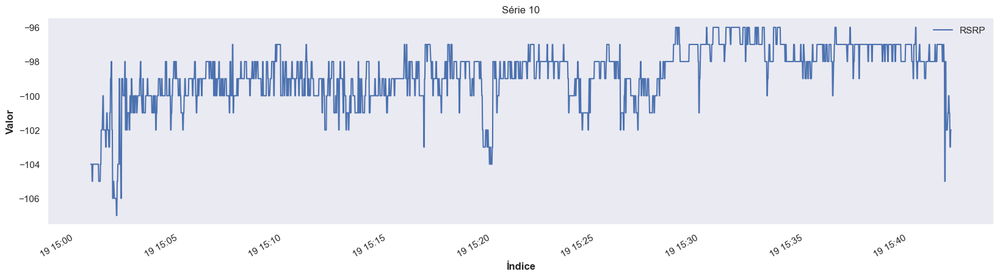

<Figure size 1000x600 with 0 Axes>

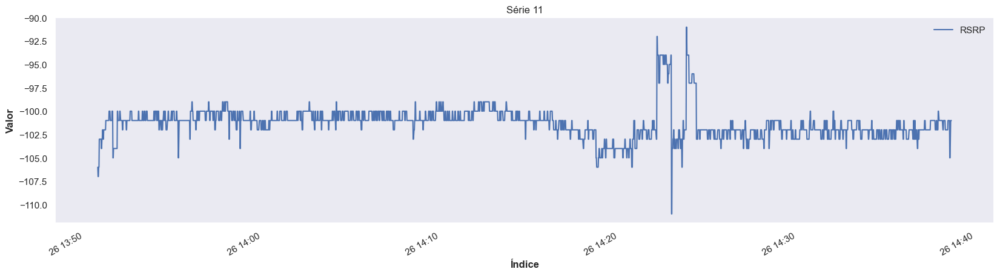

<Figure size 1000x600 with 0 Axes>

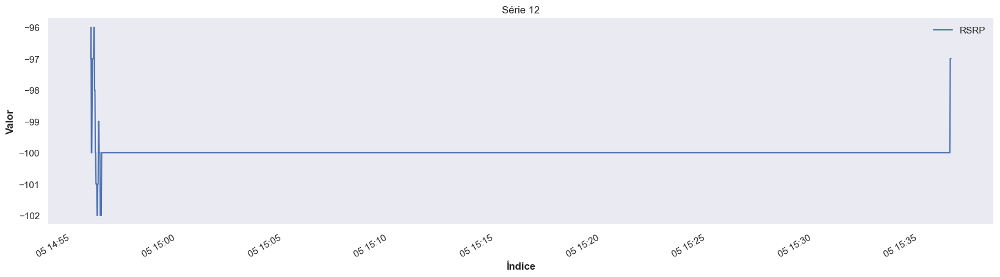

<Figure size 1000x600 with 0 Axes>

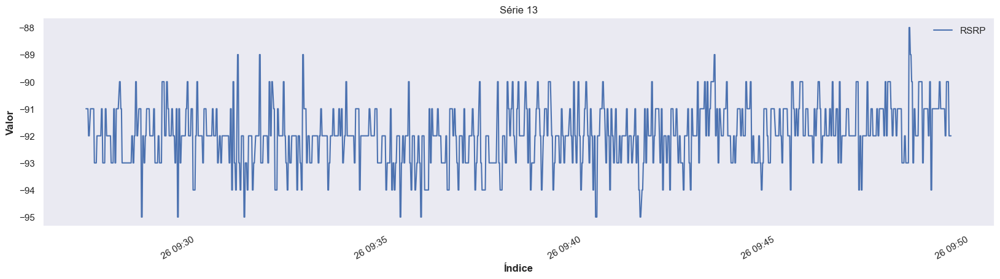

<Figure size 1000x600 with 0 Axes>

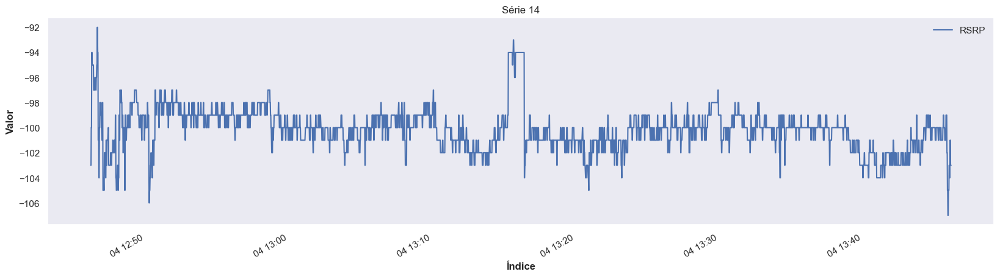

<Figure size 1000x600 with 0 Axes>

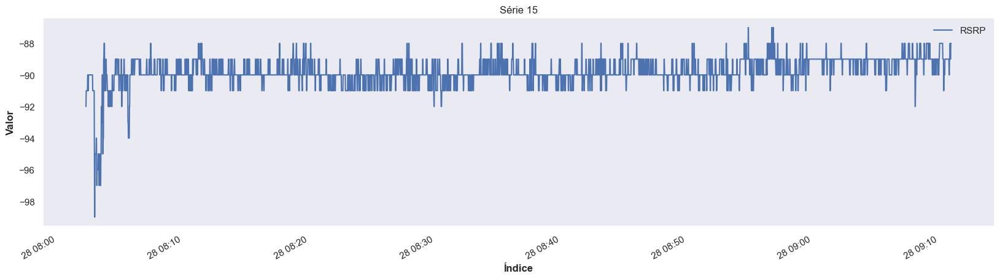

<Figure size 1000x600 with 0 Axes>

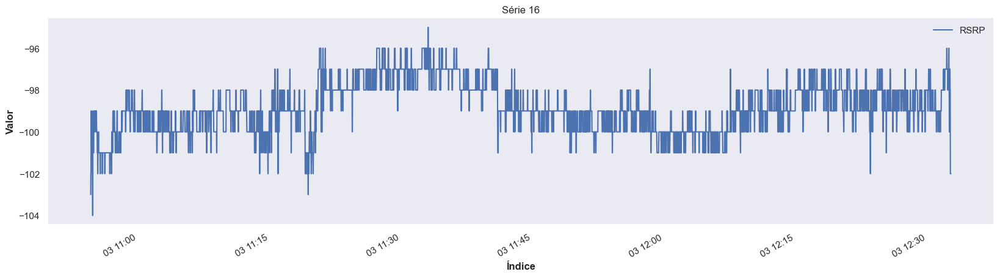

<Figure size 1000x600 with 0 Axes>

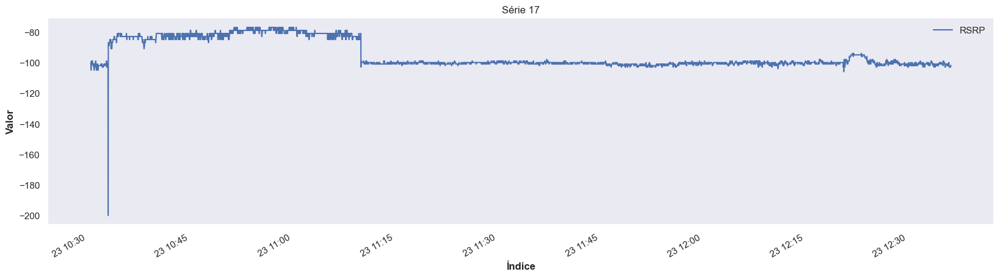

In [111]:
plot_splits_by_uid(df)

### Driving Downloading

In [112]:
path = os.path.join(
    os.pardir, "data", "reduced_metrics_datasets", "driving_down_metrics.pkl"
)

with open(path, "rb") as f:
    df = pickle.load(f)

In [113]:
df.head(5)

,Uid,Timestamp,RSRP,RSRQ,SNR,CQI,RSSI
0,2i3xVGAy,"[2020-02-27 17:30:15, 2020-02-27 17:30:16, 202...","[-99.0, -99.0, -99.0, -99.0, -98.0, -98.0, -99...","[-12.0, -13.0, -12.0, -12.0, -11.0, -11.0, -12...","[-1.0, -2.0, 0.0, 0.0, -1.0, -1.0, -1.0, -1.0,...","[14.0, 14.0, 9.0, 9.0, 14.0, 14.0, 10.0, 10.0,...","[-105.0, -105.0, -105.0, -105.0, -105.0, -105...."
1,3d2bUSbc,"[2019-12-17 07:32:39, 2019-12-17 07:32:40, 201...","[-103.0, -103.0, -103.0, -103.0, -103.0, -103....","[-11.0, -10.0, -11.0, -11.0, -13.0, -13.0, -12...","[0.0, 7.0, 8.0, 8.0, 10.0, 10.0, 13.0, 13.0, 9...","[11.0, 11.0, 11.0, 11.0, 11.0, 11.0, 11.0, 11....","[-87.0, -87.0, -87.0, -87.0, -87.0, -87.0, -87..."
2,5RstCeuH,"[2020-02-14 12:58:17, 2020-02-14 12:58:18, 202...","[-98.0, -99.0, -99.0, -99.0, -99.0, -99.0, -10...","[-11.0, -9.0, -9.0, -9.0, -11.0, -11.0, -12.0,...","[4.0, 8.0, 8.0, 8.0, 2.0, 2.0, 9.0, 9.0, -1.0,...","[10.0, 14.0, 14.0, 14.0, 15.0, 15.0, 15.0, 15....","[-105.0, -107.0, -107.0, -107.0, -107.0, -107...."
3,6tCci24Z,"[2019-12-14 10:16:30, 2019-12-14 10:16:31, 201...","[-99.0, -99.0, -102.0, -102.0, -102.0, -102.0,...","[-15.0, -15.0, -14.0, -14.0, -14.0, -14.0, -13...","[6.0, 6.0, 6.0, 6.0, 4.0, 4.0, 4.0, 4.0, 4.0, ...","[12.0, 12.0, 12.0, 12.0, 12.0, 12.0, 12.0, 12....","[-90.0, -90.0, -90.0, -90.0, -90.0, -90.0, -90..."
4,JgN9XvDs,"[2020-02-14 09:38:22, 2020-02-14 09:38:25, 202...","[-89.0, -88.0, -88.0, -88.0, -88.0, -88.0, -88...","[-12.0, -10.0, -10.0, -11.0, -11.0, -12.0, -12...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, ...","[10.0, 10.0, 10.0, 10.0, 10.0, 9.0, 9.0, 10.0,...","[-89.0, -89.0, -89.0, -89.0, -91.0, -89.0, -87..."


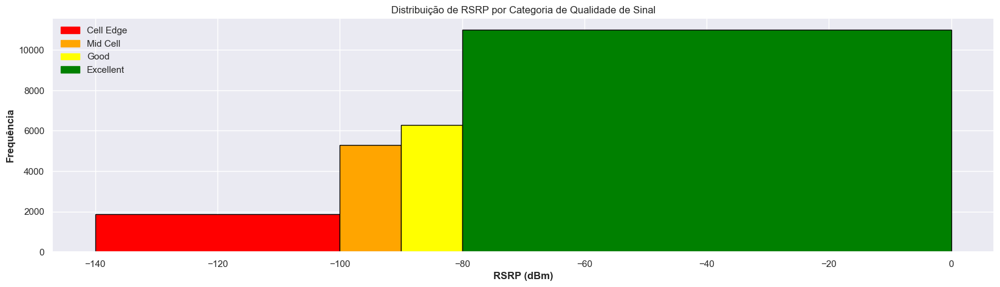

In [114]:
plot_rsrp_distribution(df)

<Figure size 1000x600 with 0 Axes>

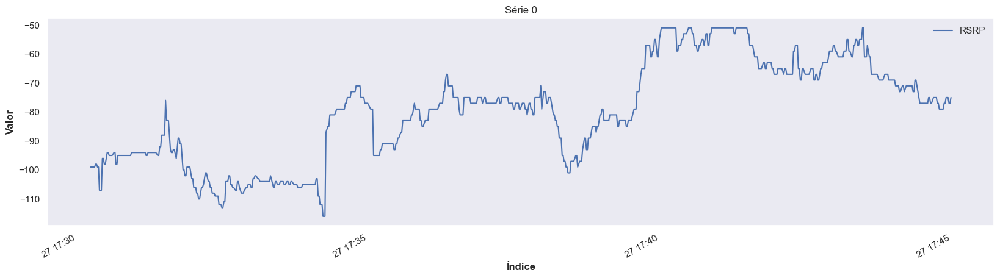

<Figure size 1000x600 with 0 Axes>

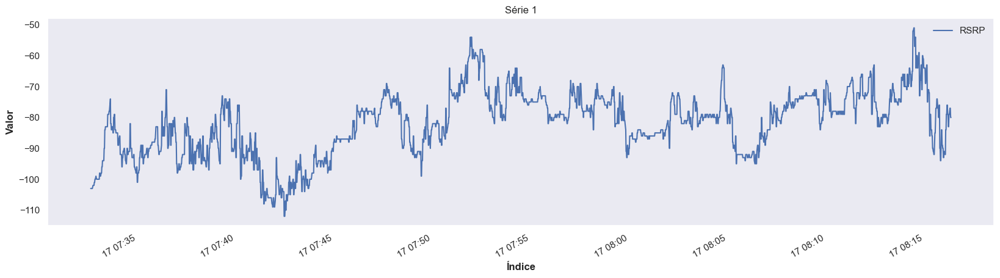

<Figure size 1000x600 with 0 Axes>

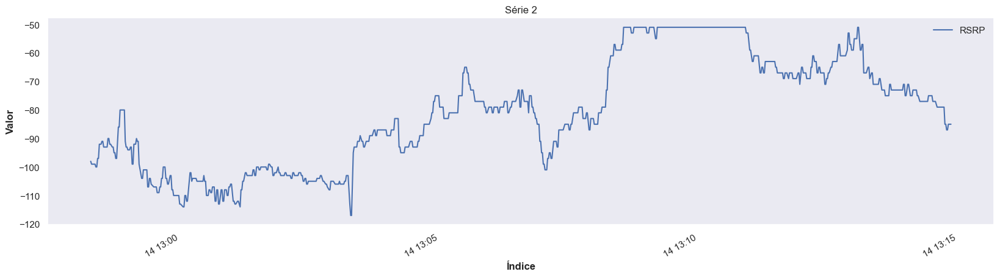

<Figure size 1000x600 with 0 Axes>

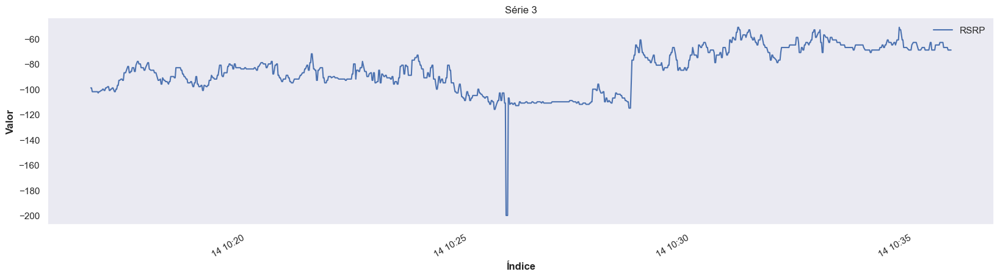

<Figure size 1000x600 with 0 Axes>

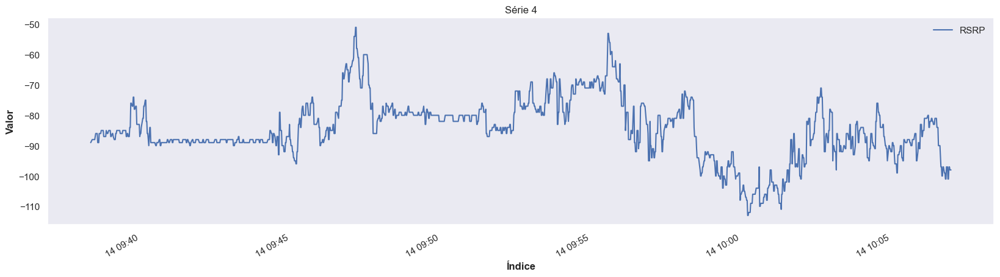

<Figure size 1000x600 with 0 Axes>

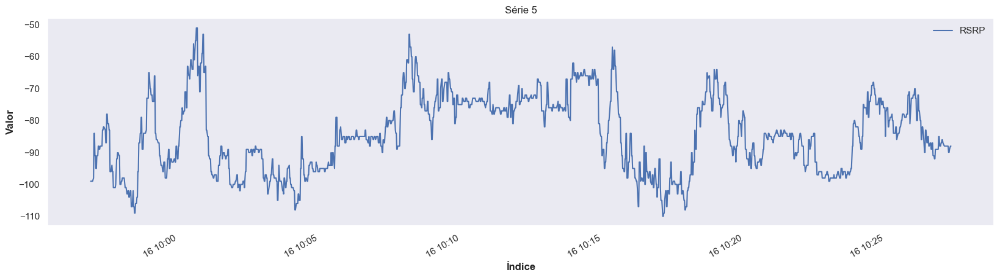

<Figure size 1000x600 with 0 Axes>

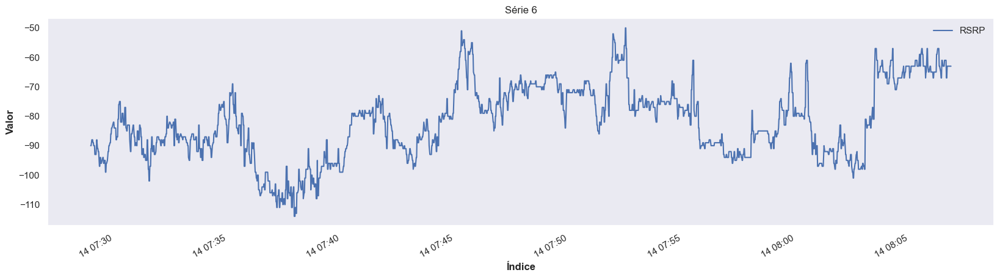

<Figure size 1000x600 with 0 Axes>

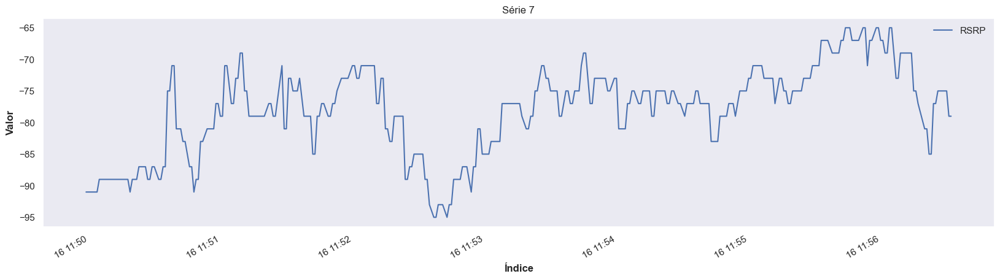

<Figure size 1000x600 with 0 Axes>

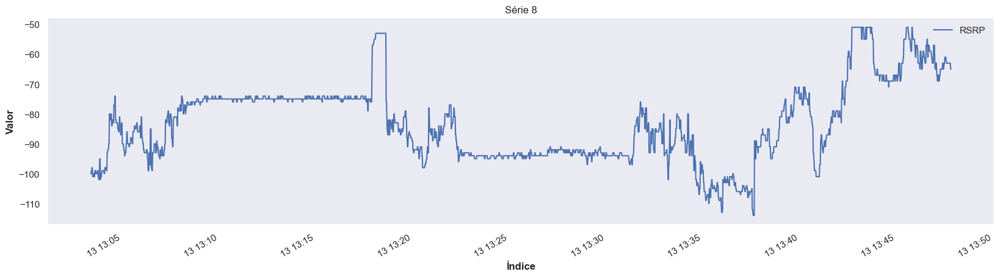

<Figure size 1000x600 with 0 Axes>

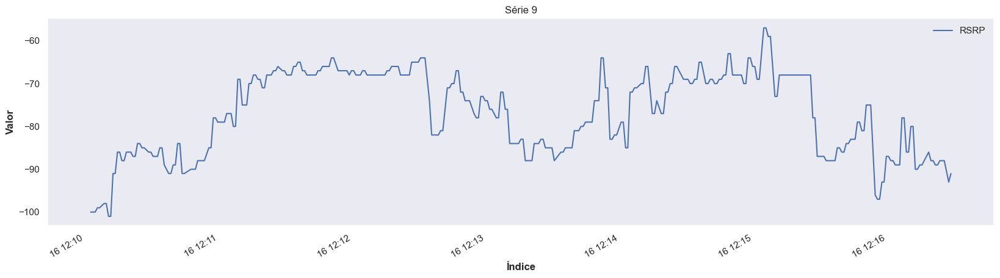

<Figure size 1000x600 with 0 Axes>

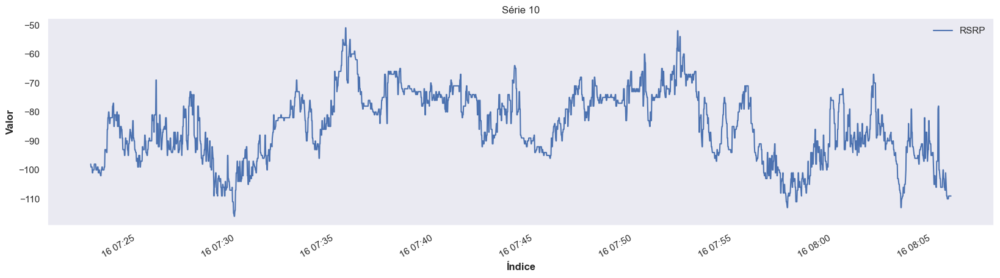

<Figure size 1000x600 with 0 Axes>

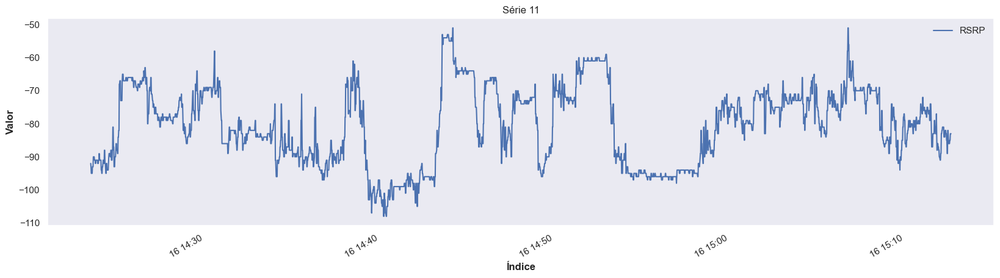

<Figure size 1000x600 with 0 Axes>

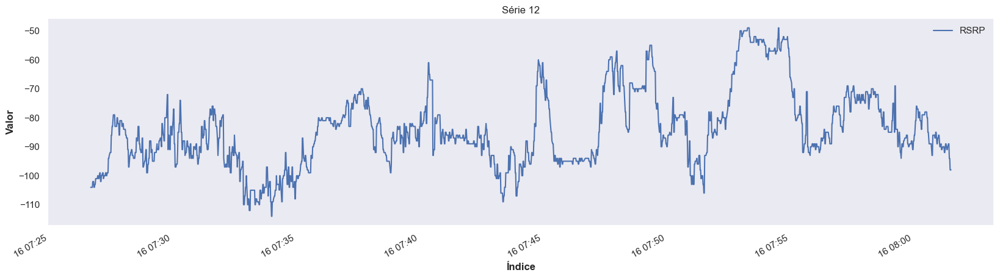

<Figure size 1000x600 with 0 Axes>

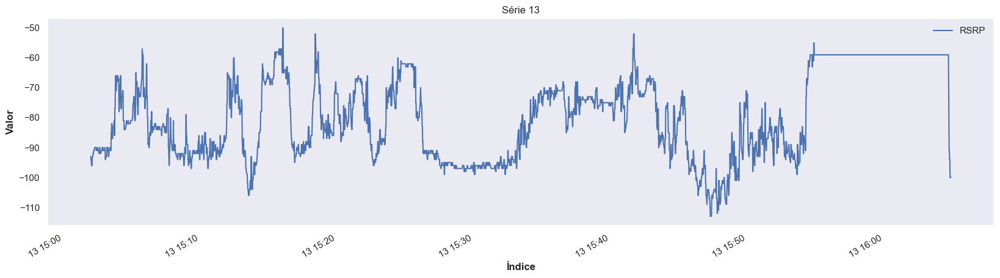

<Figure size 1000x600 with 0 Axes>

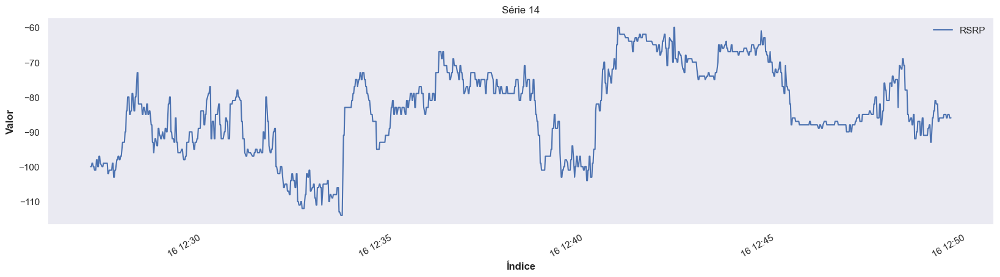

<Figure size 1000x600 with 0 Axes>

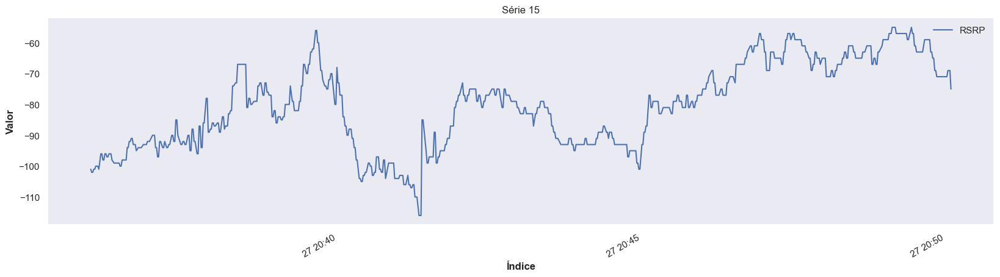

In [115]:
plot_splits_by_uid(df)

### Driving Streaming

In [116]:
path = os.path.join(
    os.pardir, "data", "reduced_metrics_datasets", "driving_strm_metrics.pkl"
)

with open(path, "rb") as f:
    df = pickle.load(f)

In [117]:
df.head(5)

,Uid,Timestamp,RSRP,RSRQ,SNR,CQI,RSSI
0,2aiDfriZ,"[2019-11-28 07:27:57, 2019-11-28 07:27:58, 201...","[-102.0, -102.0, -102.0, -102.0, -103.0, -103....","[-10.0, -10.0, -10.0, -10.0, -11.0, -11.0, -11...","[8.0, 8.0, 3.0, 3.0, 6.0, 6.0, 1.0, 1.0, 8.0, ...","[14.0, 14.0, 14.0, 14.0, 14.0, 14.0, 14.0, 14....","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ..."
1,3bAEmT2F,"[2019-11-25 15:34:34, 2019-11-25 15:34:36, 201...","[-79.0, -78.0, -77.0, -77.0, -78.0, -78.0, -78...","[-12.0, -12.0, -12.0, -12.0, -12.0, -12.0, -12...","[10.0, 9.0, 10.0, 10.0, 9.0, 9.0, 8.0, 8.0, 8....","[8.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0, ...","[-61.0, -61.0, -61.0, -61.0, -61.0, -61.0, -61..."
2,5jCVwHc2,"[2019-12-06 07:31:16, 2019-12-06 07:31:17, 201...","[-99.0, -97.0, -97.0, -99.0, -99.0, -99.0, -99...","[-13.0, -10.0, -10.0, -9.0, -9.0, -10.0, -10.0...","[1.0, 9.0, 9.0, 14.0, 14.0, 12.0, 12.0, 6.0, 6...","[15.0, 12.0, 12.0, 12.0, 12.0, 12.0, 12.0, 12....","[-86.0, -84.0, -84.0, -86.0, -86.0, -86.0, -86..."
3,685cemyR,"[2019-11-21 16:15:17, 2019-11-21 16:15:18, 201...","[-82.0, -82.0, -81.0, -81.0, -83.0, -83.0, -87...","[-8.0, -7.0, -8.0, -8.0, -6.0, -6.0, -9.0, -9....","[11.0, 15.0, 15.0, 15.0, 14.0, 14.0, 10.0, 10....","[12.0, 8.0, 8.0, 11.0, 11.0, 11.0, 11.0, 11.0,...","[-65.0, -67.0, -67.0, -64.0, -64.0, -70.0, -70..."
4,6RSMmwzr,"[2019-11-29 09:37:23, 2019-11-29 09:37:24, 201...","[-84.0, -83.0, -85.0, -85.0, -85.0, -85.0, -83...","[-12.0, -14.0, -14.0, -14.0, -12.0, -12.0, -11...","[5.0, 9.0, 15.0, 15.0, 7.0, 7.0, 4.0, 4.0, 3.0...","[15.0, 15.0, 15.0, 15.0, 14.0, 14.0, 14.0, 14....","[-67.0, -69.0, -69.0, -69.0, -66.0, -66.0, -66..."


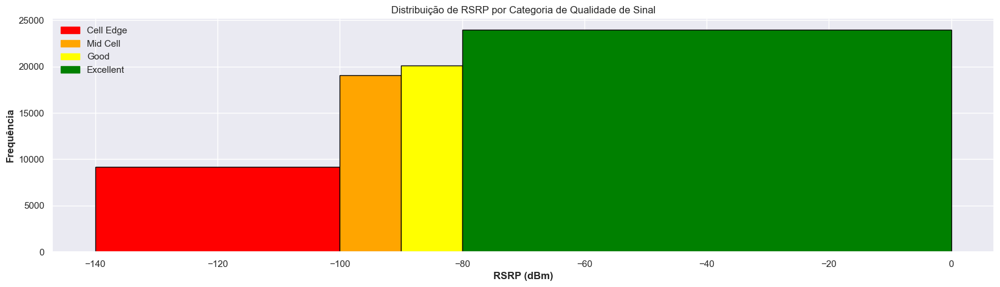

In [118]:
plot_rsrp_distribution(df)

<Figure size 1000x600 with 0 Axes>

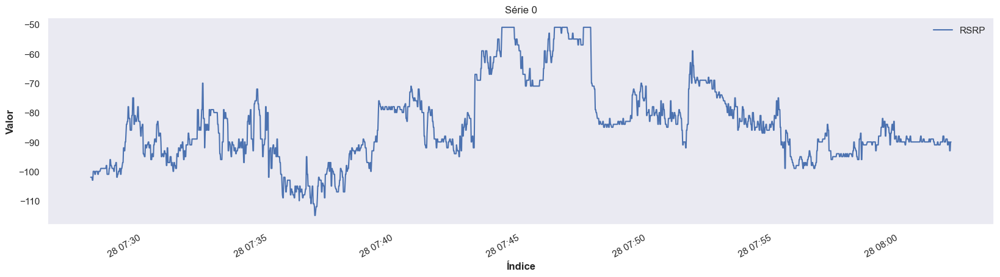

<Figure size 1000x600 with 0 Axes>

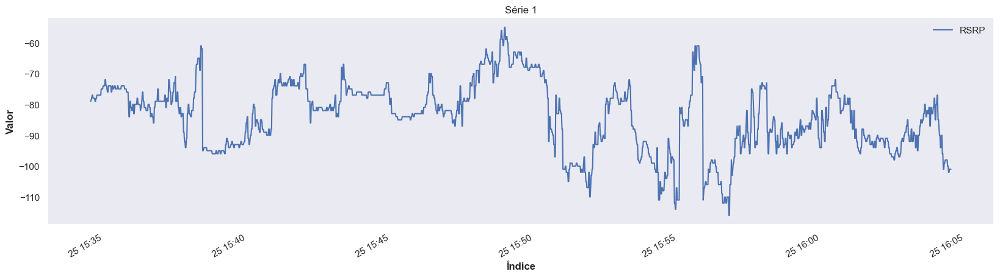

<Figure size 1000x600 with 0 Axes>

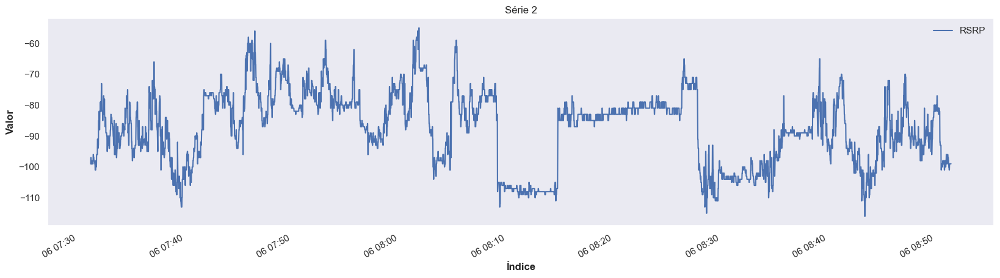

<Figure size 1000x600 with 0 Axes>

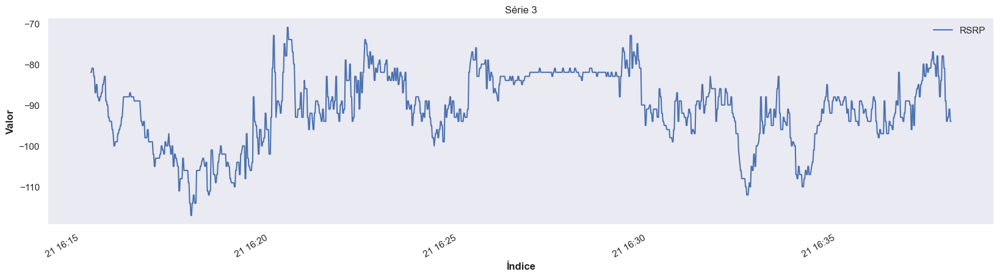

<Figure size 1000x600 with 0 Axes>

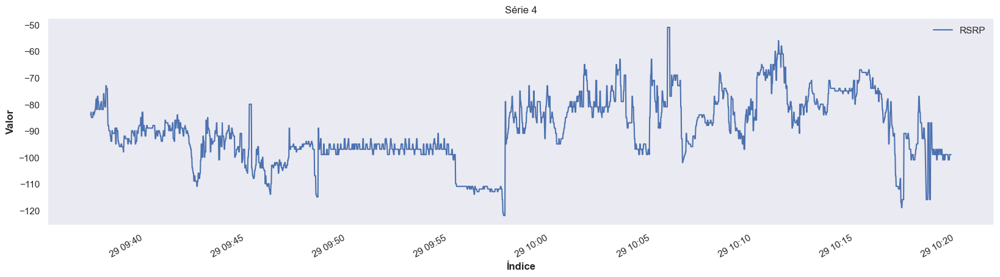

<Figure size 1000x600 with 0 Axes>

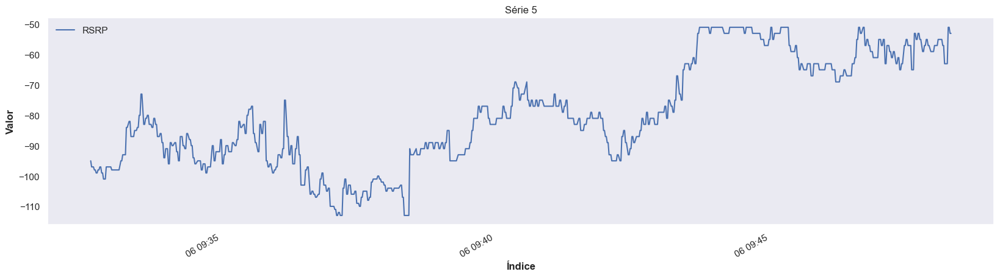

<Figure size 1000x600 with 0 Axes>

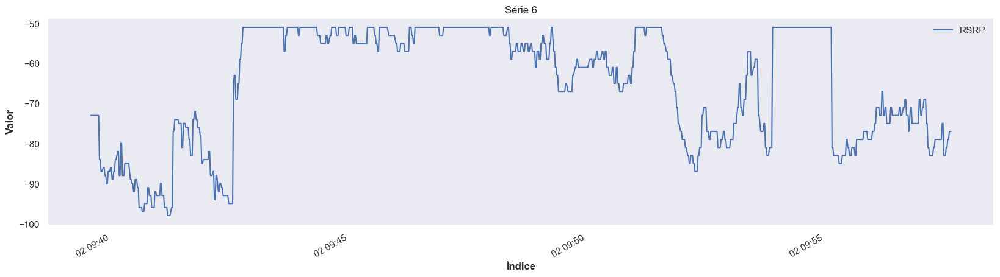

<Figure size 1000x600 with 0 Axes>

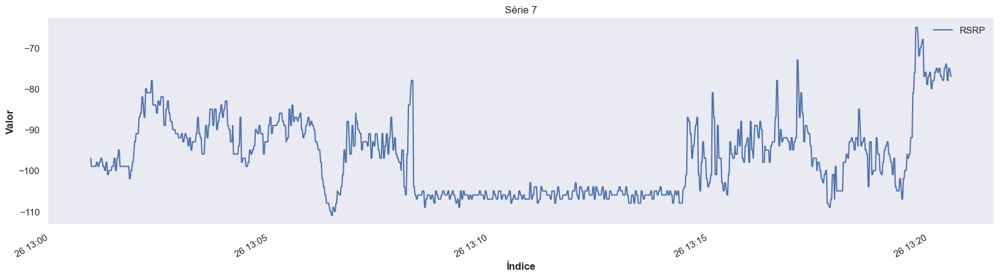

<Figure size 1000x600 with 0 Axes>

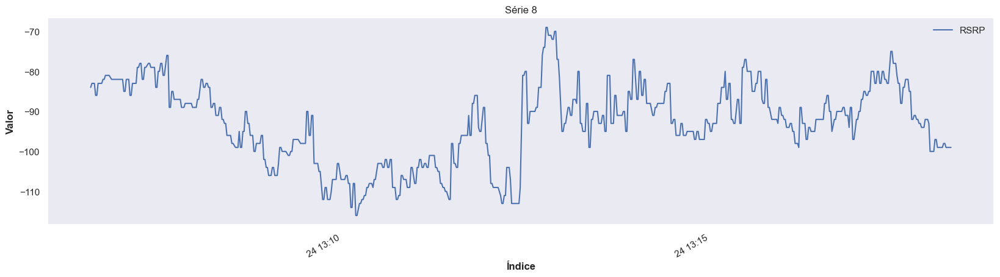

<Figure size 1000x600 with 0 Axes>

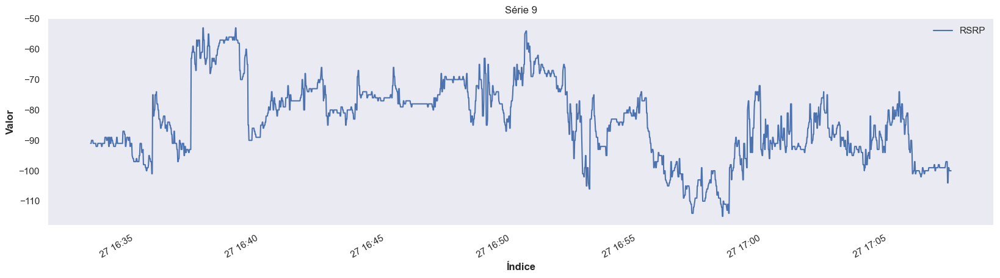

<Figure size 1000x600 with 0 Axes>

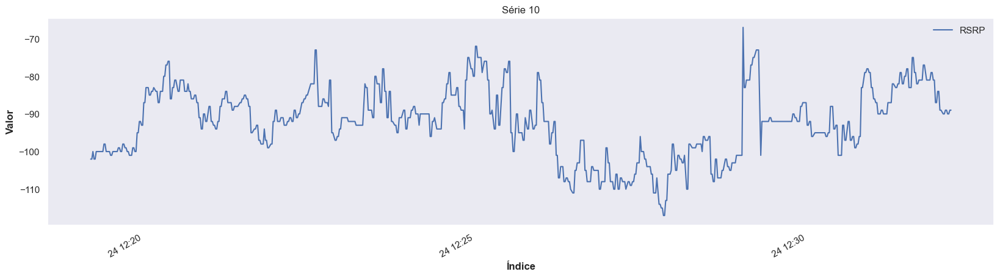

<Figure size 1000x600 with 0 Axes>

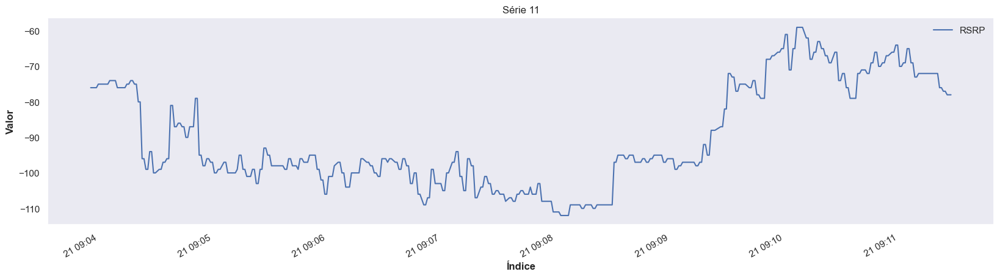

<Figure size 1000x600 with 0 Axes>

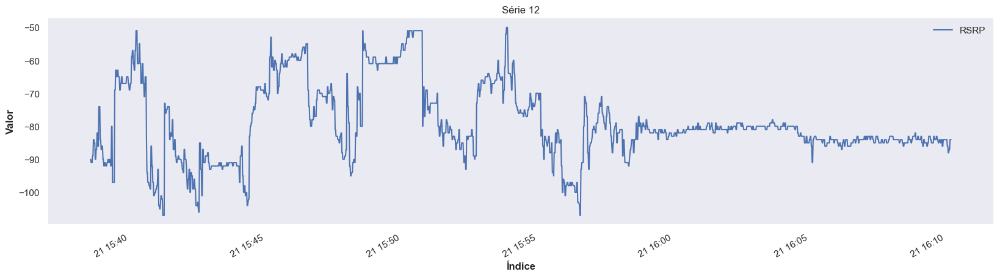

<Figure size 1000x600 with 0 Axes>

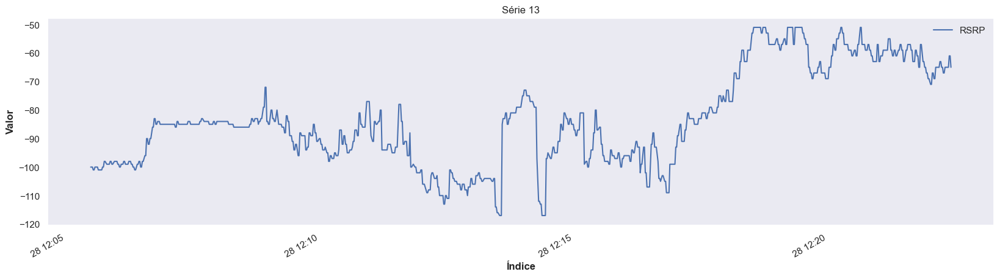

<Figure size 1000x600 with 0 Axes>

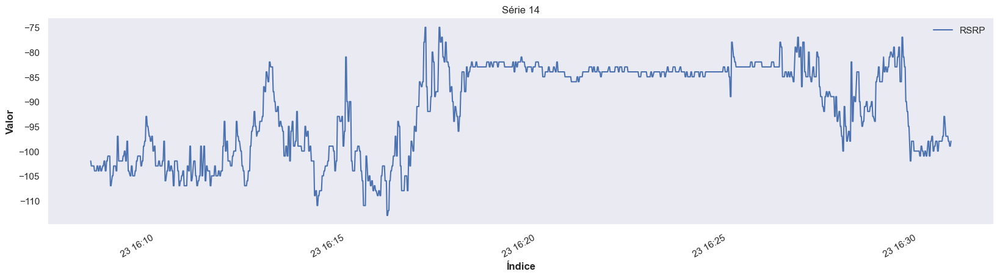

<Figure size 1000x600 with 0 Axes>

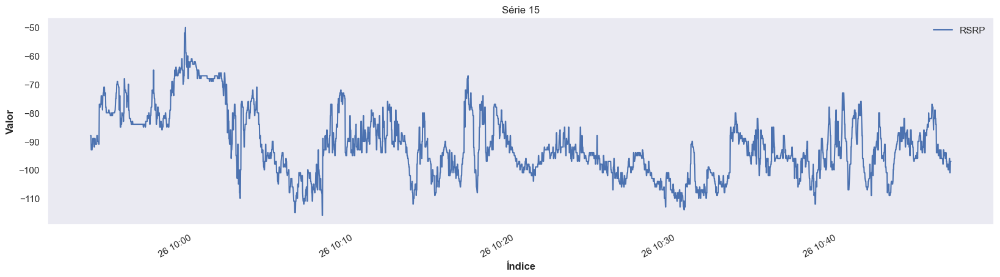

<Figure size 1000x600 with 0 Axes>

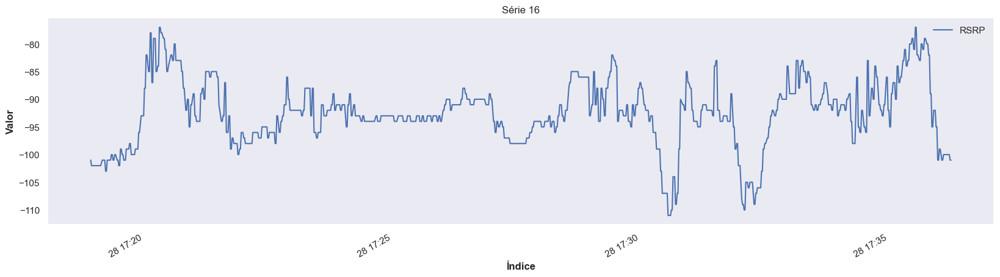

<Figure size 1000x600 with 0 Axes>

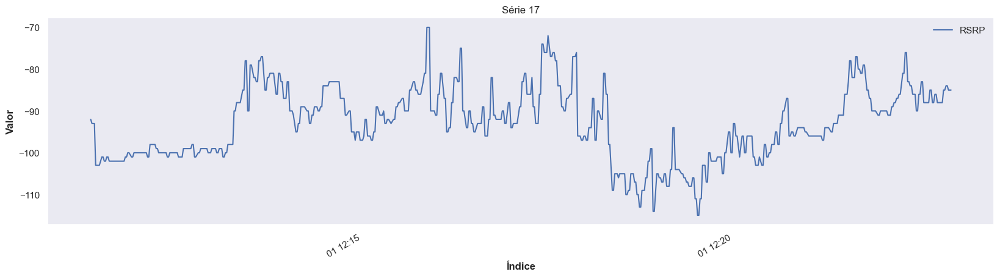

<Figure size 1000x600 with 0 Axes>

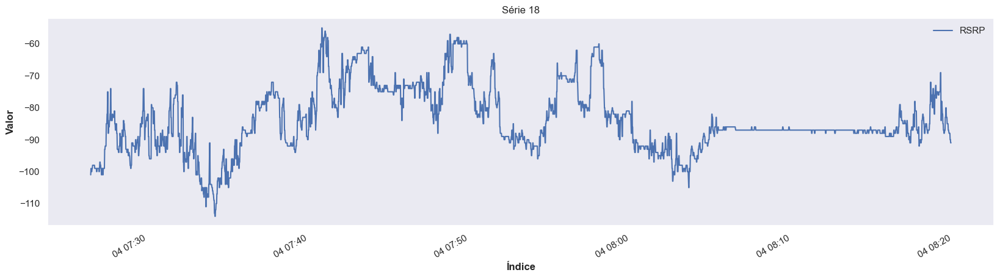

<Figure size 1000x600 with 0 Axes>

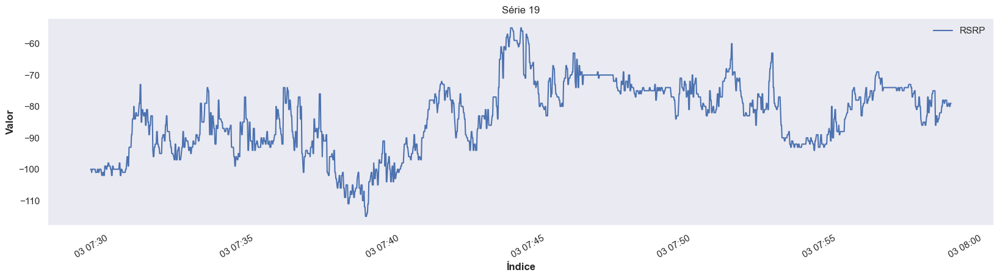

<Figure size 1000x600 with 0 Axes>

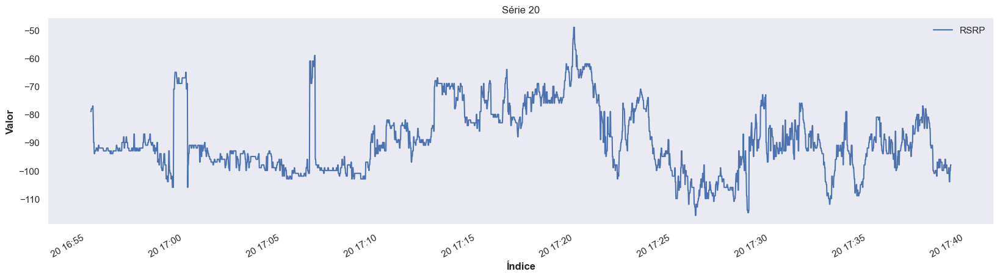

<Figure size 1000x600 with 0 Axes>

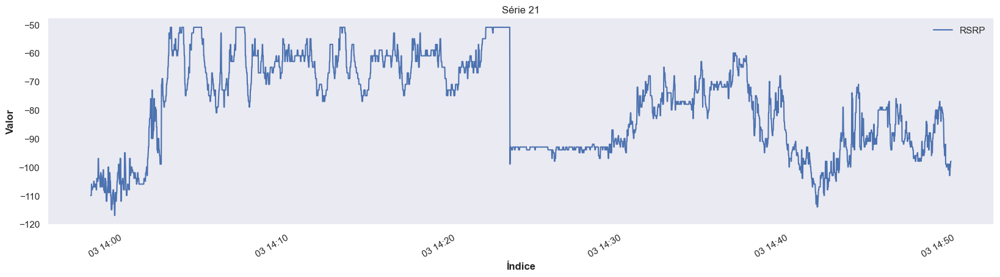

<Figure size 1000x600 with 0 Axes>

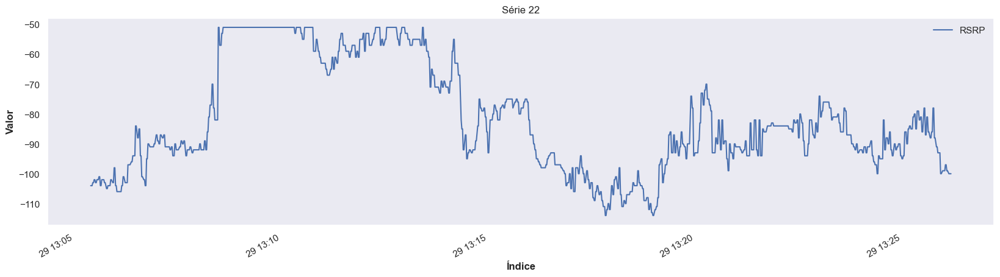

<Figure size 1000x600 with 0 Axes>

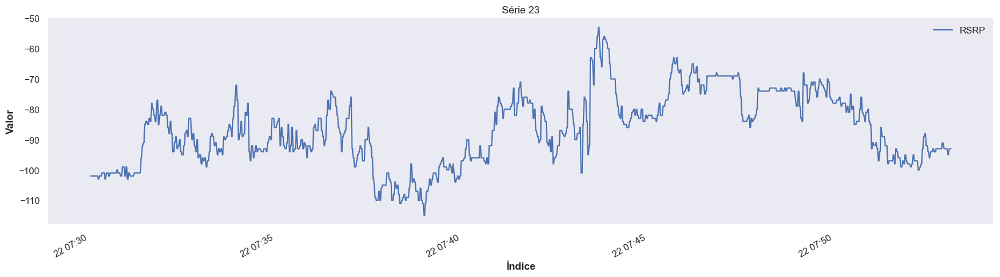

<Figure size 1000x600 with 0 Axes>

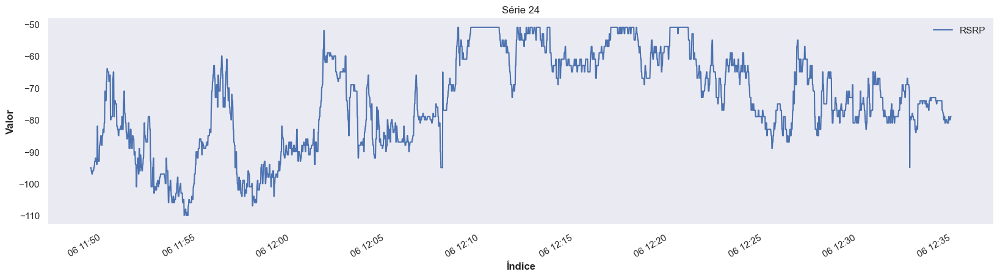

<Figure size 1000x600 with 0 Axes>

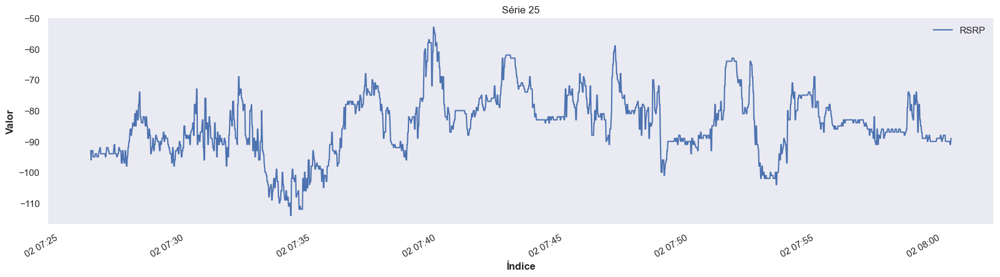

<Figure size 1000x600 with 0 Axes>

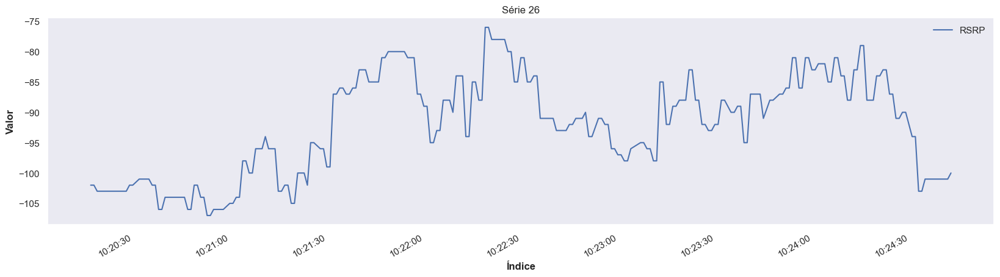

<Figure size 1000x600 with 0 Axes>

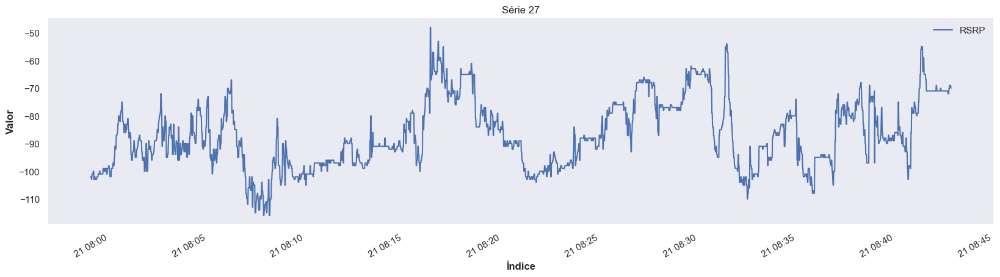

<Figure size 1000x600 with 0 Axes>

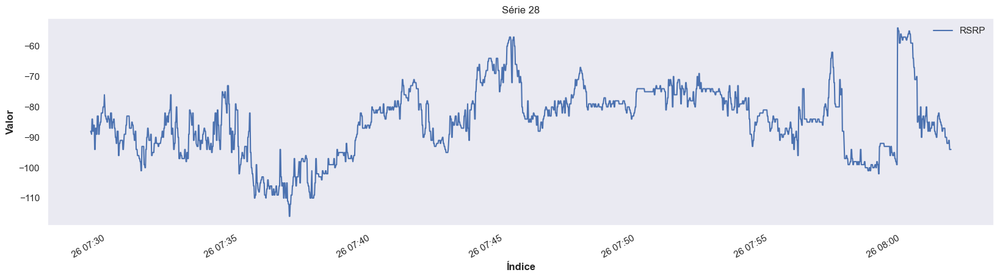

<Figure size 1000x600 with 0 Axes>

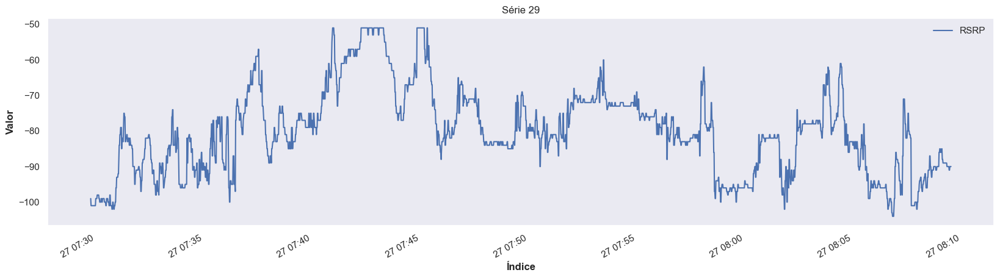

<Figure size 1000x600 with 0 Axes>

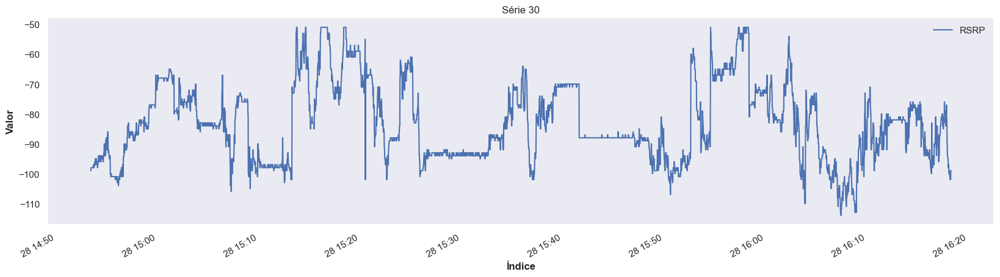

<Figure size 1000x600 with 0 Axes>

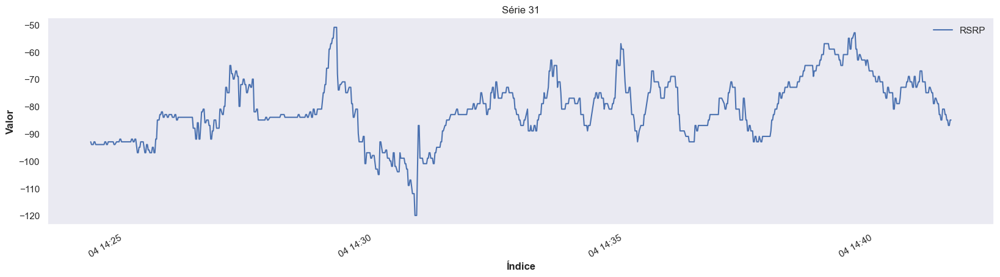

<Figure size 1000x600 with 0 Axes>

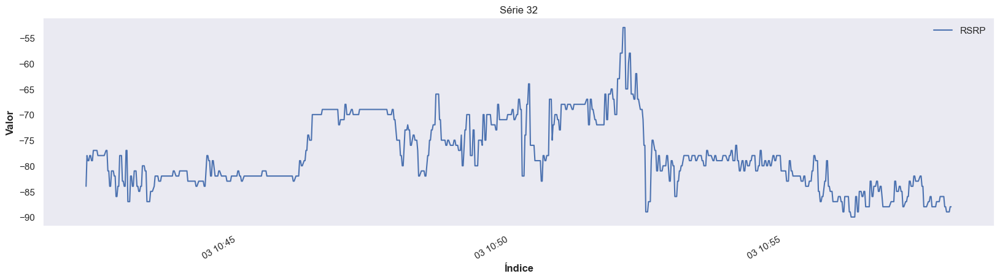

<Figure size 1000x600 with 0 Axes>

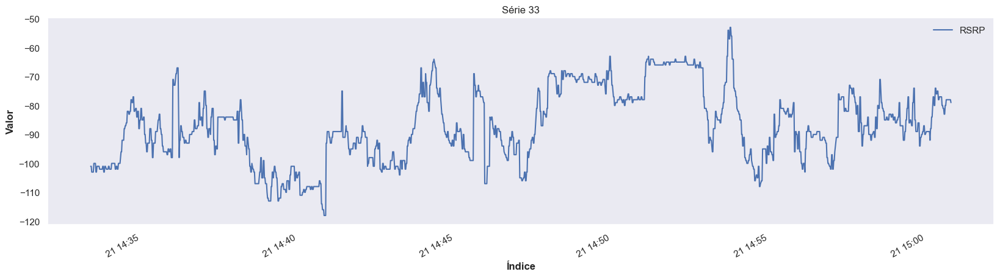

<Figure size 1000x600 with 0 Axes>

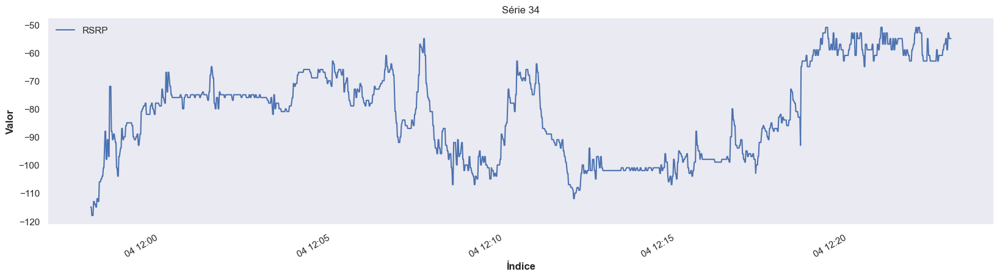

<Figure size 1000x600 with 0 Axes>

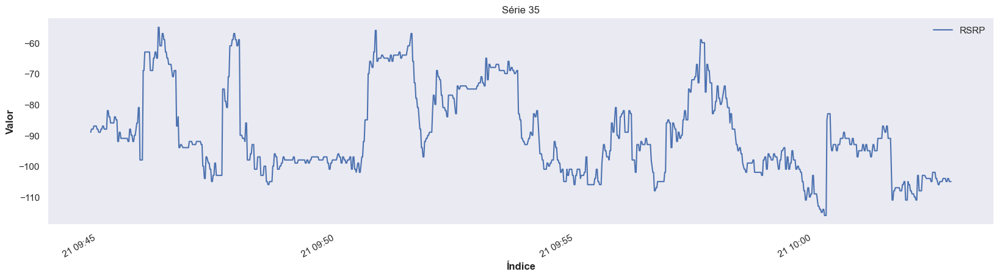

<Figure size 1000x600 with 0 Axes>

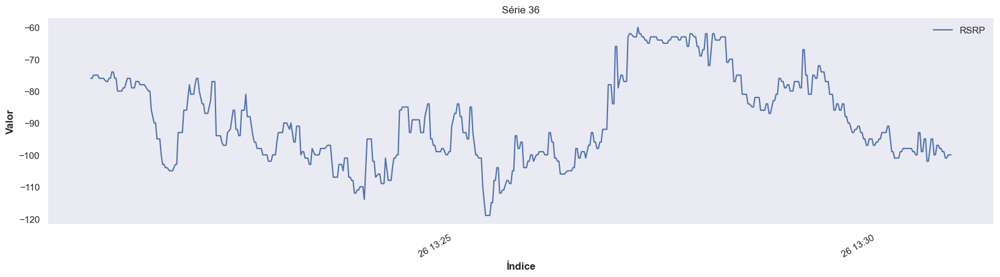

<Figure size 1000x600 with 0 Axes>

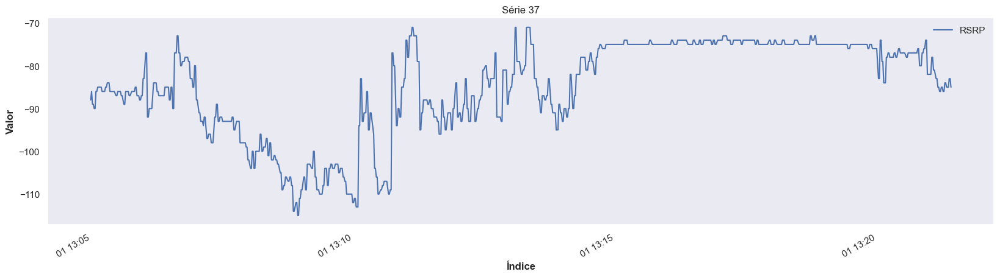

<Figure size 1000x600 with 0 Axes>

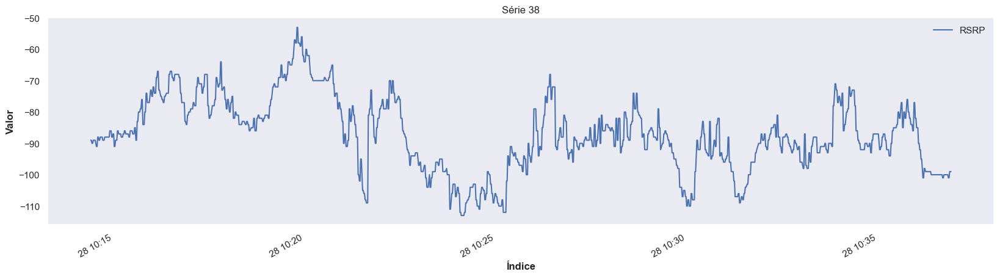

<Figure size 1000x600 with 0 Axes>

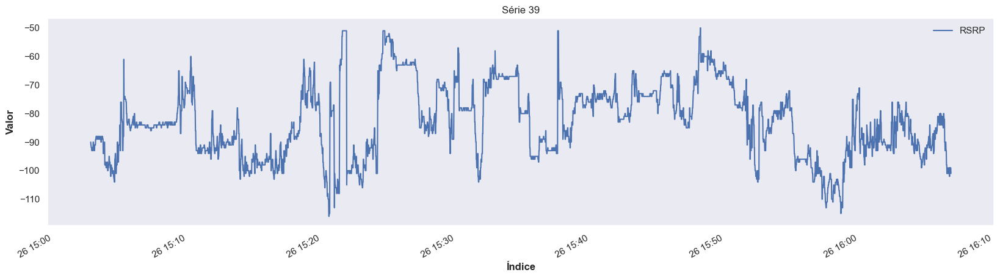

<Figure size 1000x600 with 0 Axes>

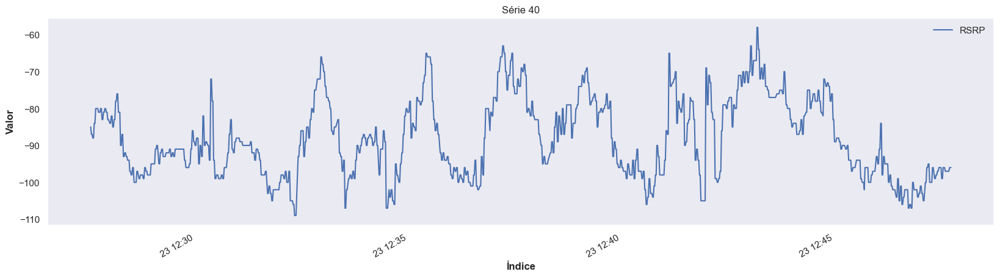

<Figure size 1000x600 with 0 Axes>

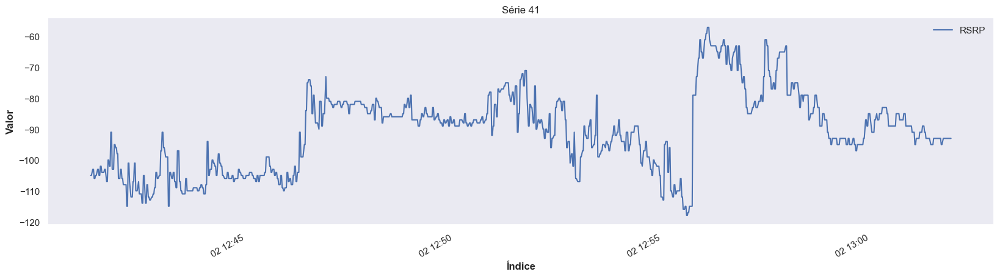

<Figure size 1000x600 with 0 Axes>

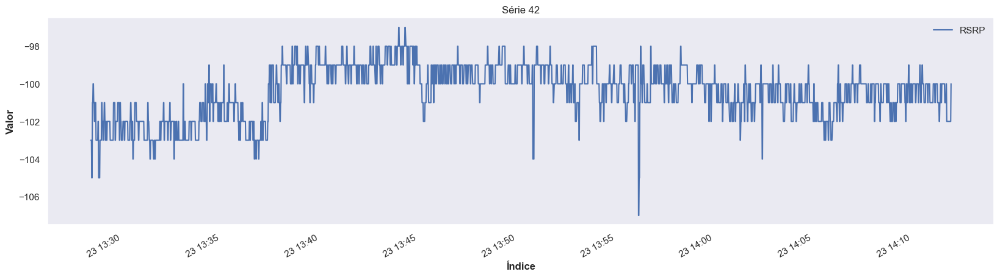

<Figure size 1000x600 with 0 Axes>

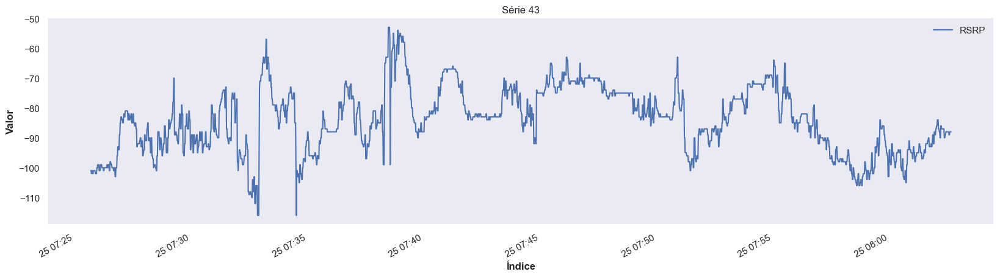

In [119]:
plot_splits_by_uid(df)

# Analisando o comportamento das séries

## Augmented Dickey-Fuller Test

In [120]:
processed_series = []
for idx, row in df.iterrows():
    subseries = train_process_timeseries(
        row, "RSRP"
    )
    if subseries:
        processed_series.extend(subseries)

[INFO] Missing ratio for RSRP: 10.94%
[INFO] Missing ratio for RSRP: 7.12%
[INFO] Missing ratio for RSRP: 11.42%
[INFO] Missing ratio for RSRP: 6.81%
[INFO] Missing ratio for RSRP: 11.32%
[INFO] Missing ratio for RSRP: 9.98%
[INFO] Missing ratio for RSRP: 10.50%
[INFO] Missing ratio for RSRP: 7.31%
[INFO] Missing ratio for RSRP: 6.98%
[INFO] Missing ratio for RSRP: 7.39%
[INFO] Missing ratio for RSRP: 8.09%
[INFO] Missing ratio for RSRP: 6.40%
[INFO] Missing ratio for RSRP: 7.43%
[INFO] Missing ratio for RSRP: 11.60%
[INFO] Missing ratio for RSRP: 7.16%
[INFO] Missing ratio for RSRP: 7.52%
[INFO] Missing ratio for RSRP: 10.57%
[INFO] Missing ratio for RSRP: 10.76%
[INFO] Missing ratio for RSRP: 11.51%
[INFO] Missing ratio for RSRP: 11.56%
[INFO] Missing ratio for RSRP: 7.72%
[INFO] Missing ratio for RSRP: 11.39%
[INFO] Missing ratio for RSRP: 10.42%
[INFO] Missing ratio for RSRP: 6.63%
[INFO] Missing ratio for RSRP: 11.52%
[INFO] Missing ratio for RSRP: 11.66%
[INFO] Missing ratio for 

<Axes: xlabel='time'>

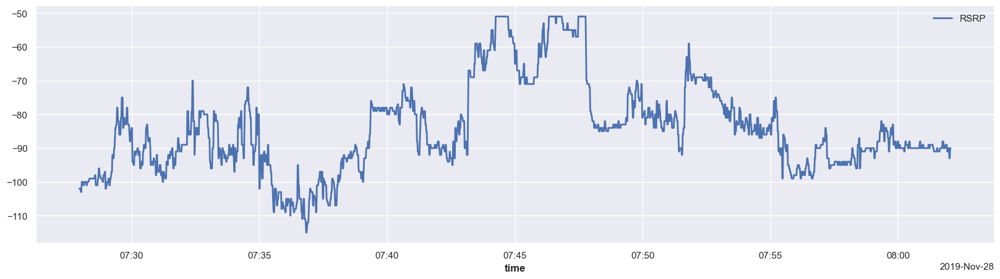

In [121]:
# Plot Timeseries processed
processed_series[0].plot()

In [122]:
for idx, serie in enumerate(processed_series):
    print(f"--- Series {idx} ---")
    adf_test(serie.pd_dataframe())

--- Series 0 ---
Augmented Dickey-Fuller Test: 
ADF test statistic        -2.825808
p-value                    0.054681
# lags used                9.000000
# observations          2037.000000
critical value (1%)       -3.433564
critical value (5%)       -2.862960
critical value (10%)      -2.567526
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary
--- Series 1 ---
Augmented Dickey-Fuller Test: 
ADF test statistic        -4.686714
p-value                    0.000089
# lags used                2.000000
# observations          1796.000000
critical value (1%)       -3.433996
critical value (5%)       -2.863151
critical value (10%)      -2.567627
Strong evidence against the null hypothesis
Reject the null hypothesis
Data has no unit root and is stationary
--- Series 2 ---
Augmented Dickey-Fuller Test: 
ADF test statistic        -5.049481
p-value                    0.000018
# lags used                5.000000
# observation

## Autocorrelation

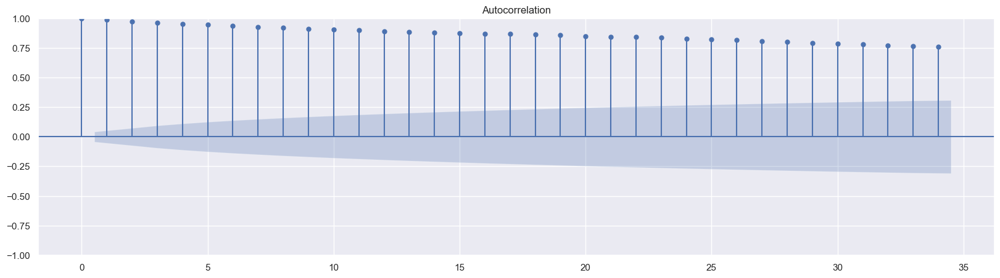

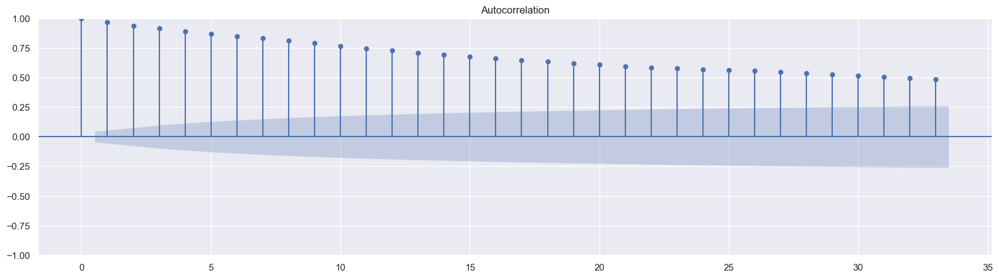

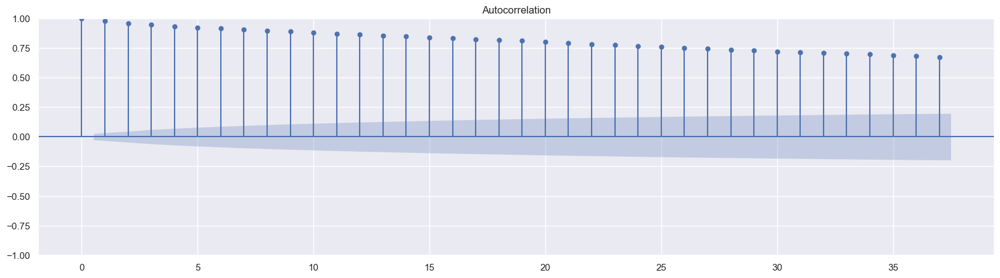

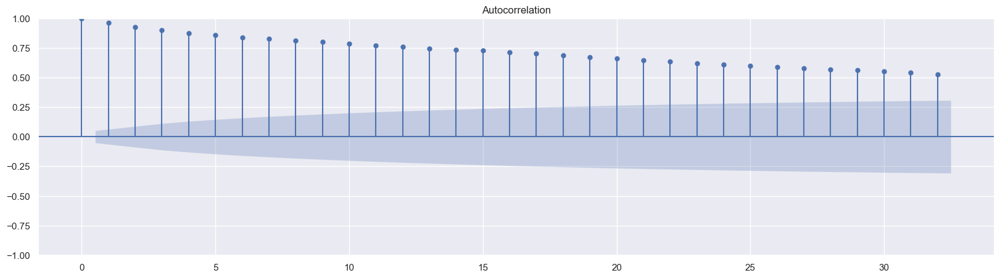

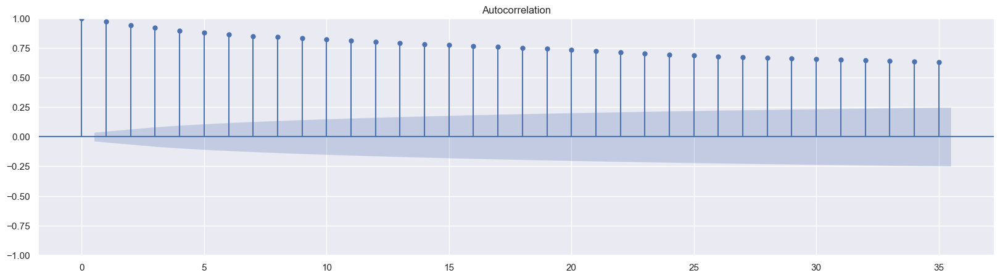

...

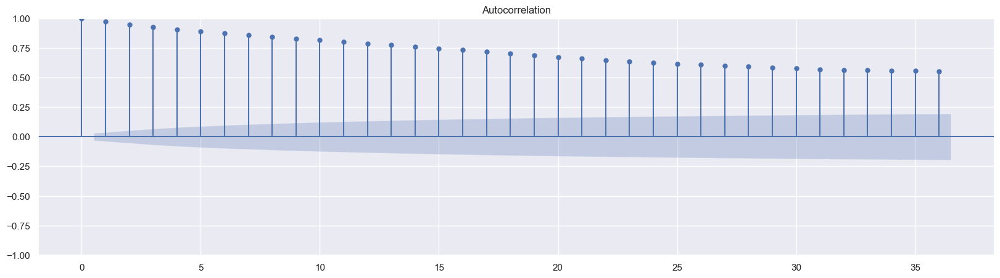

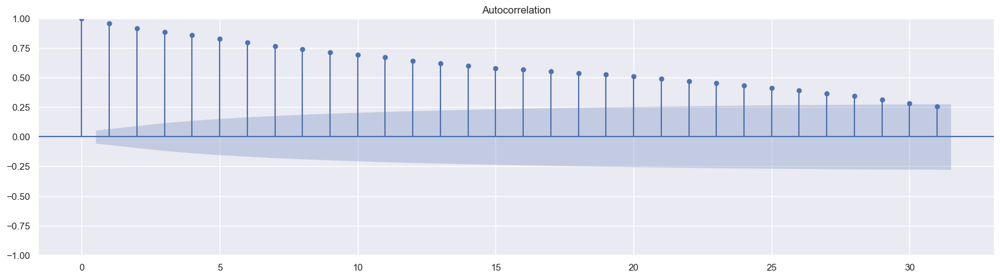

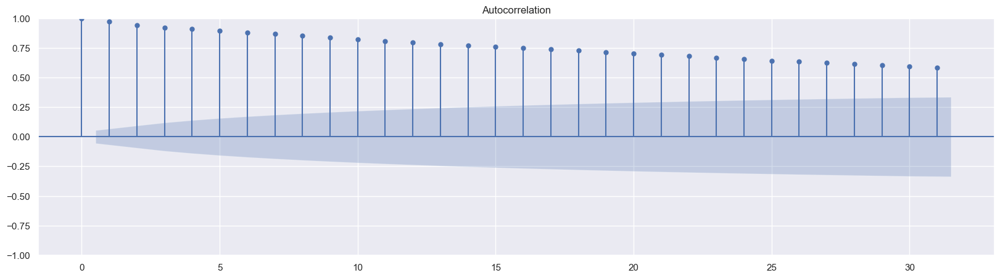

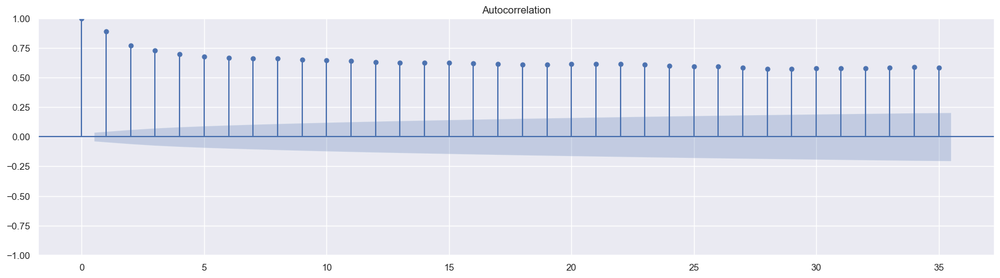

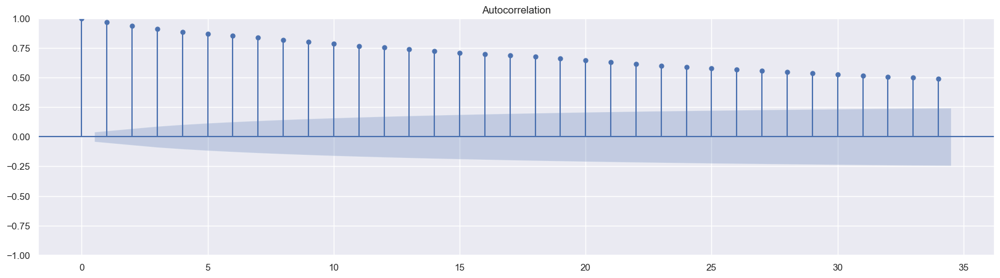

In [123]:
for idx, serie in enumerate(processed_series):
    plot_acf(serie.pd_dataframe());

## Partial Autocorrelation

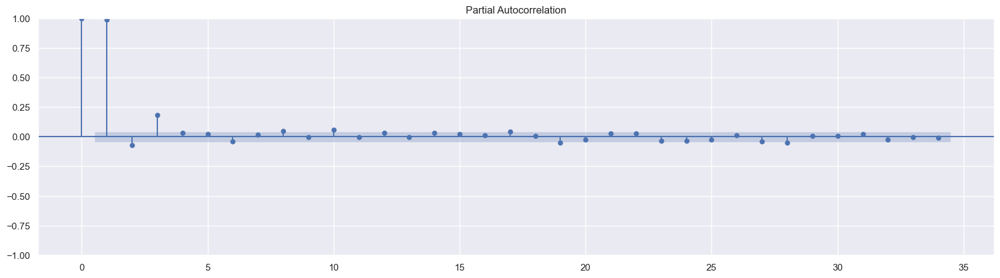

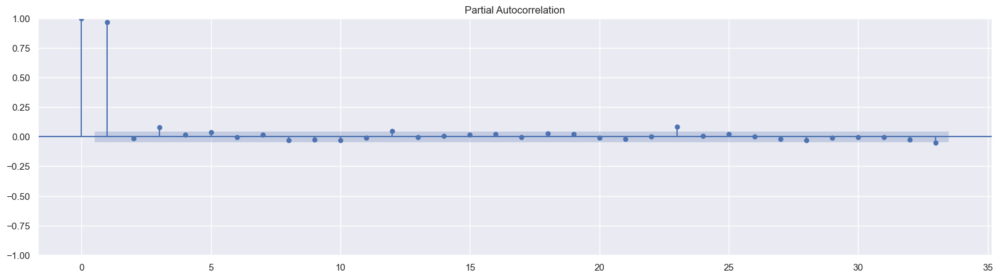

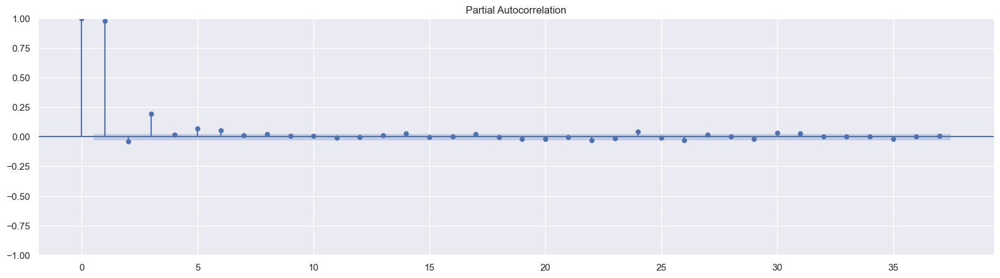

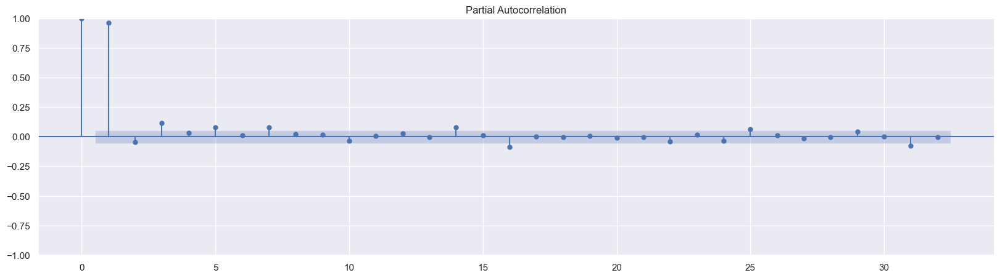

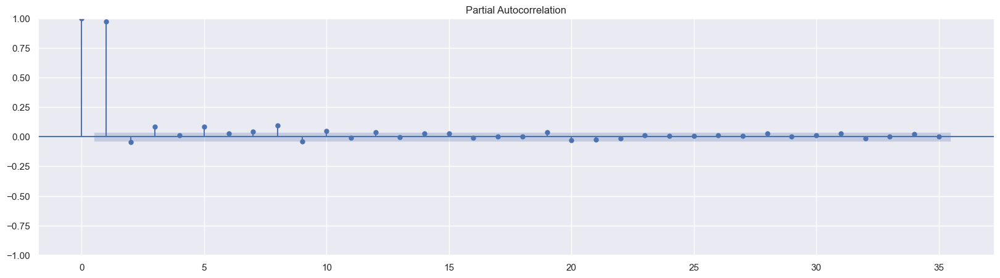

...

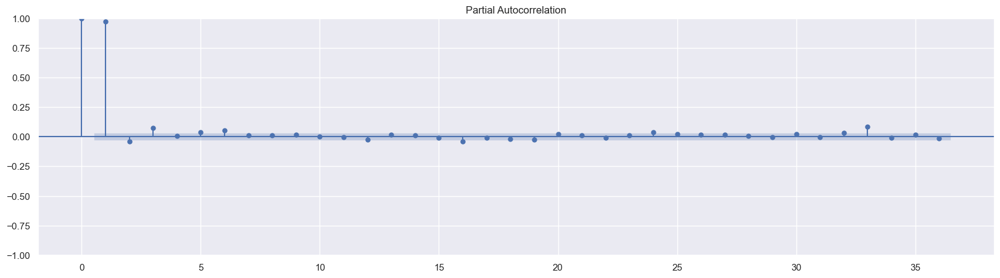

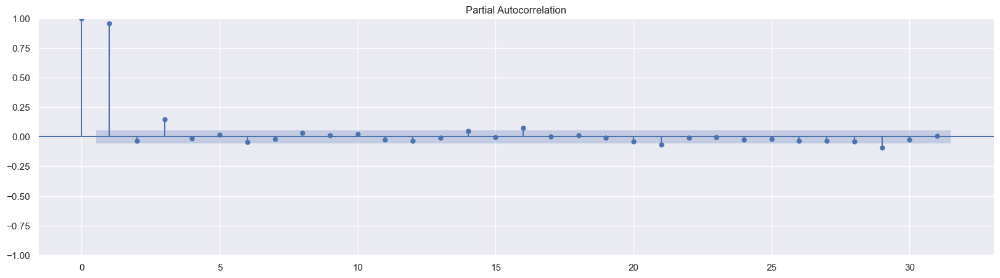

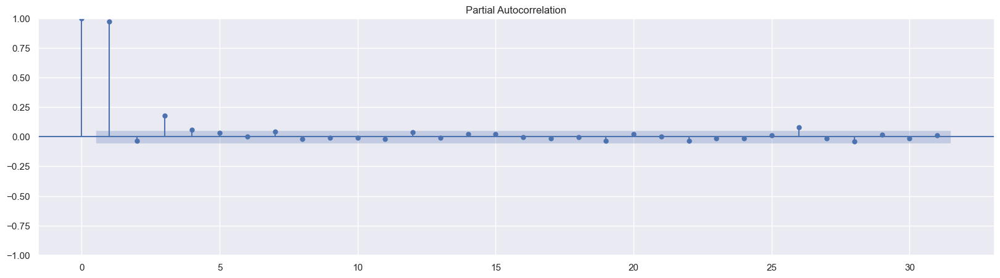

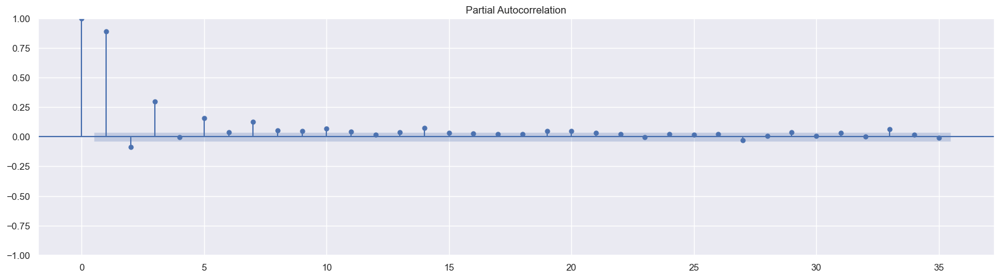

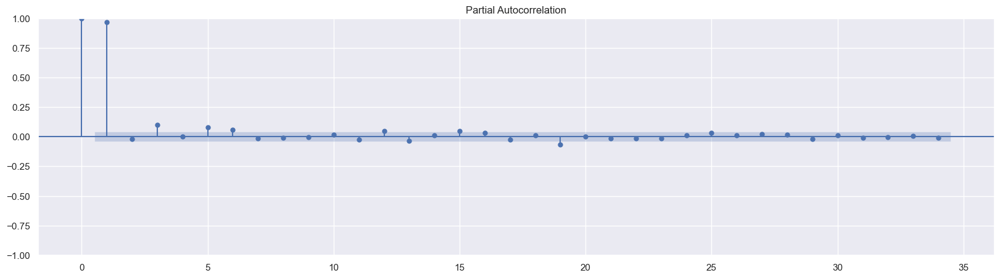

In [124]:
for idx, serie in enumerate(processed_series):
    plot_pacf(serie.pd_dataframe());

## FFT (Fast Fourier Transform)

Transforma o sinal para o domínio da frequência e ajuda a encontrar ciclos dominantes.

Dominant frequency: 0.0004885197850512946
Estimated period: 2047.0 points


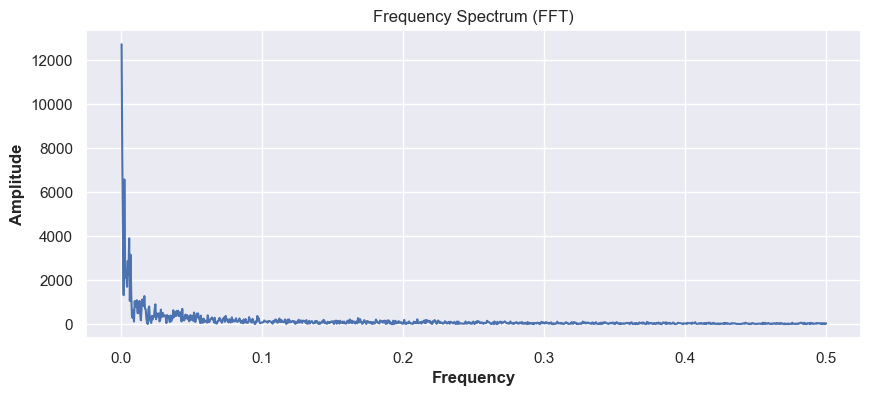

Dominant frequency: 0.0005558643690939411
Estimated period: 1799.0 points


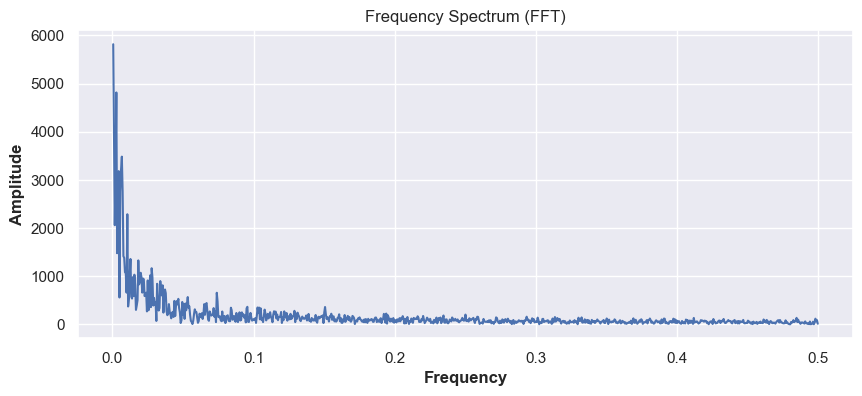

Dominant frequency: 0.00020764119601328904
Estimated period: 4816.0 points


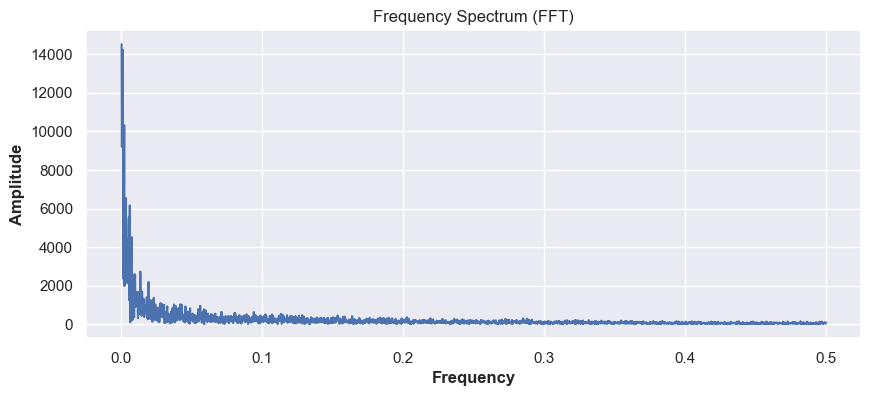

Dominant frequency: 0.0007320644216691069
Estimated period: 1366.0 points


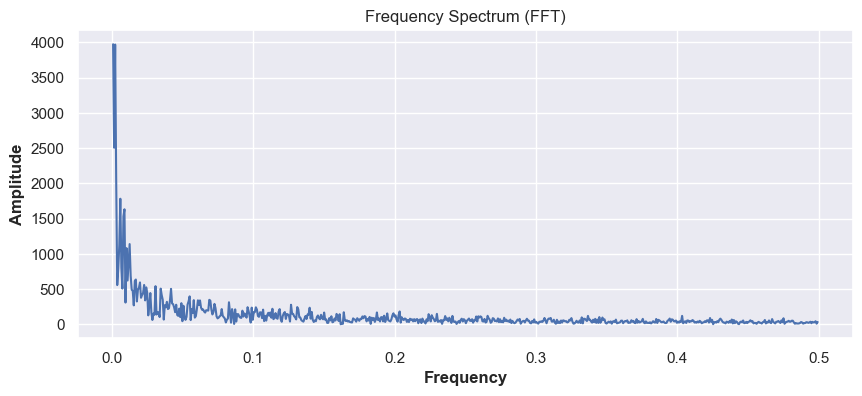

Dominant frequency: 0.0003929273084479371
Estimated period: 2545.0 points


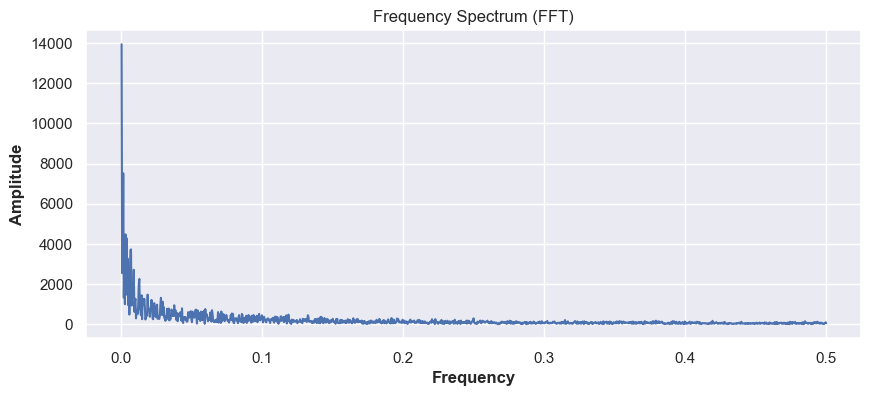

Dominant frequency: 0.0010615711252653928
Estimated period: 942.0 points


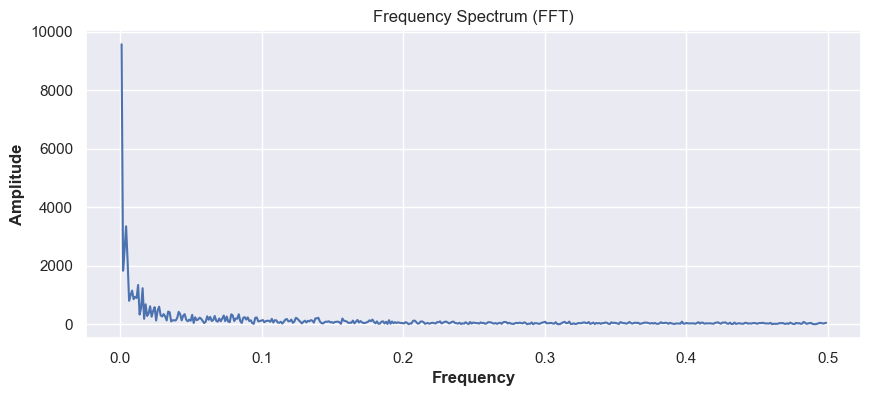

Dominant frequency: 0.0009208103130755065
Estimated period: 1086.0 points


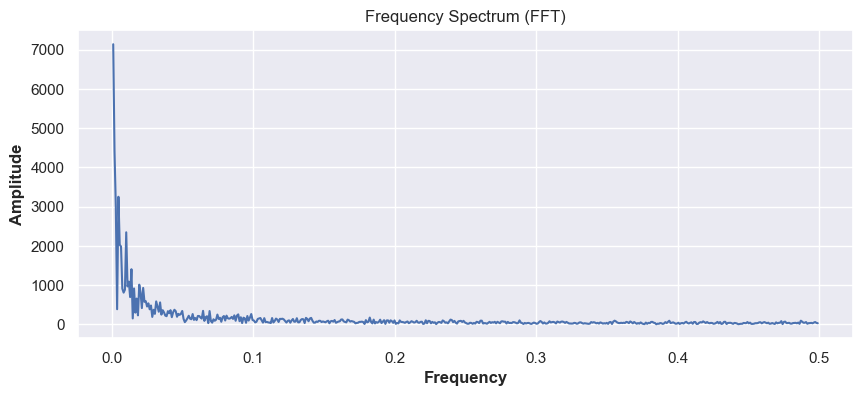

Dominant frequency: 0.0008503401360544217
Estimated period: 1176.0 points


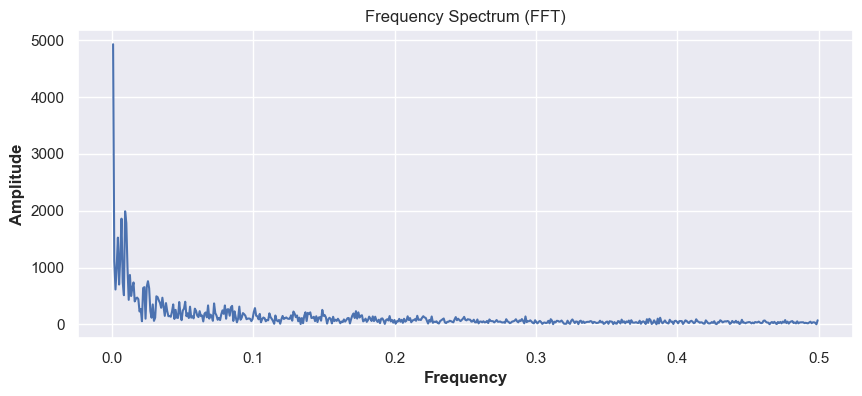

Dominant frequency: 0.0014245014245014246
Estimated period: 702.0 points


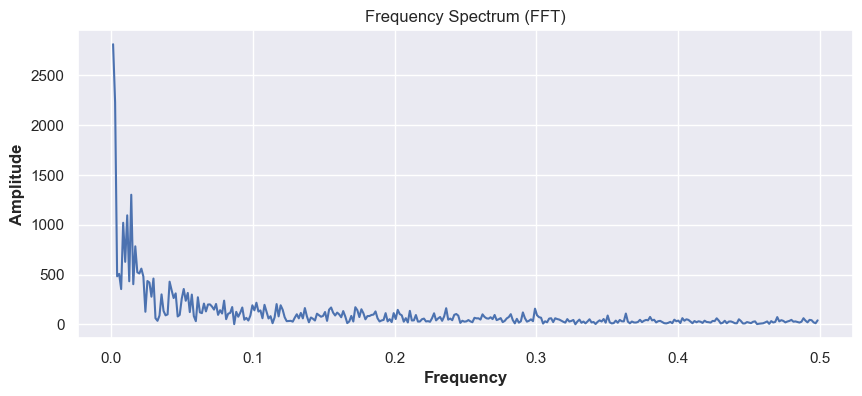

Dominant frequency: 0.00048638132295719845
Estimated period: 2056.0 points


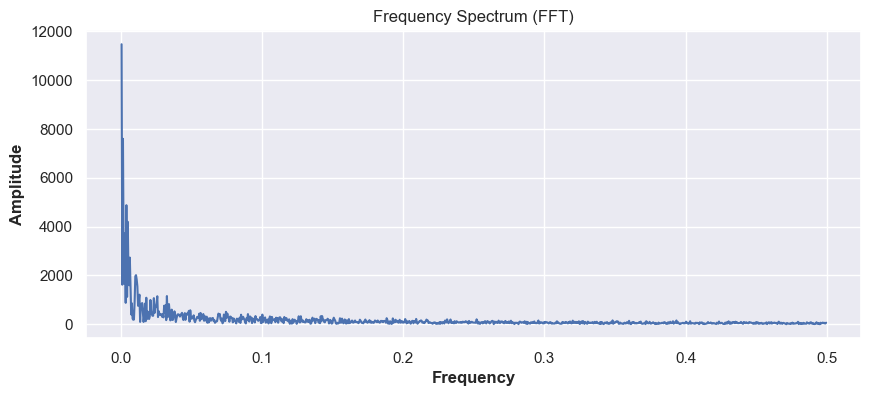

Dominant frequency: 0.0012836970474967907
Estimated period: 779.0 points


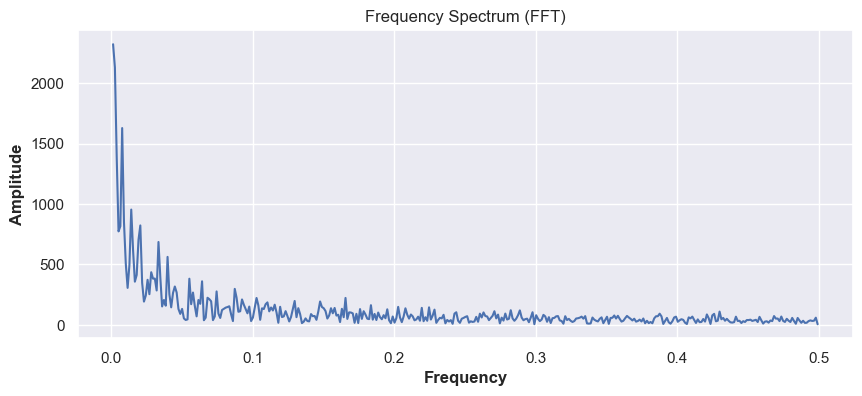

Dominant frequency: 0.002207505518763797
Estimated period: 453.0 points


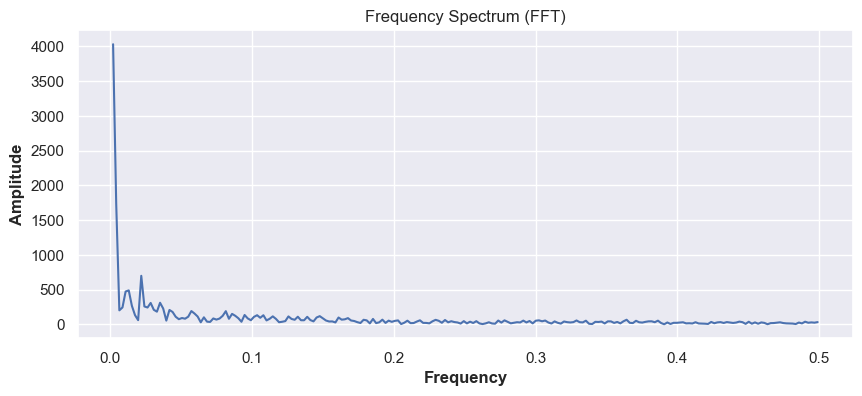

Dominant frequency: 0.0005268703898840885
Estimated period: 1898.0 points


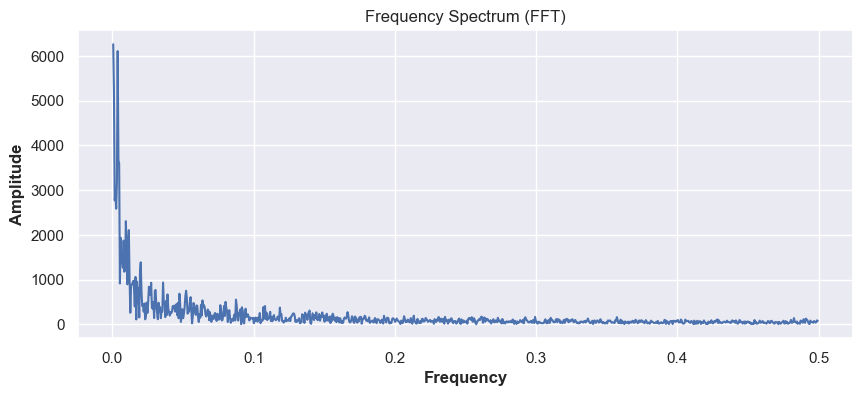

Dominant frequency: 0.0009832841691248771
Estimated period: 1017.0 points


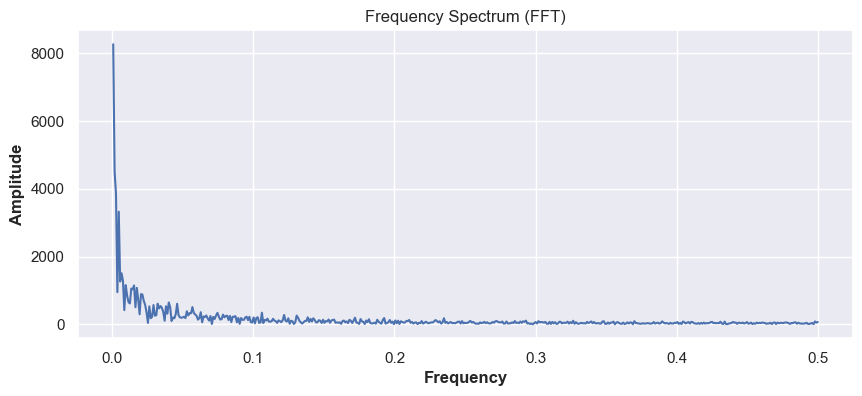

Dominant frequency: 0.0007385524372230429
Estimated period: 1354.0 points


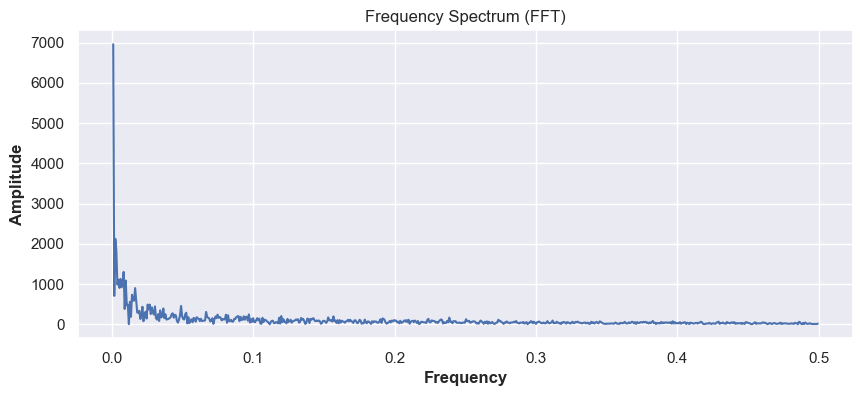

Dominant frequency: 0.00031210986267166043
Estimated period: 3204.0 points


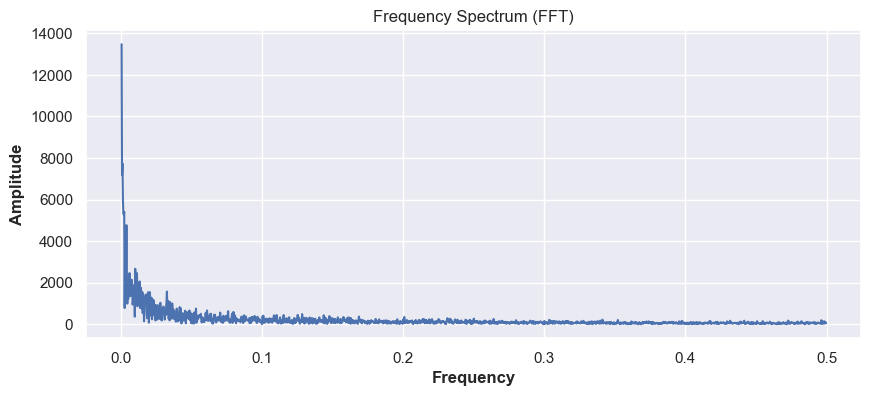

Dominant frequency: 0.007684918347742555
Estimated period: 130.1 points


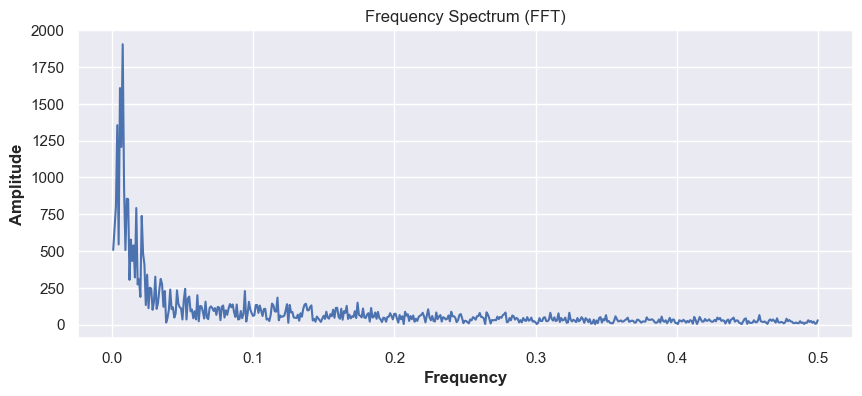

Dominant frequency: 0.0028694404591104736
Estimated period: 348.5 points


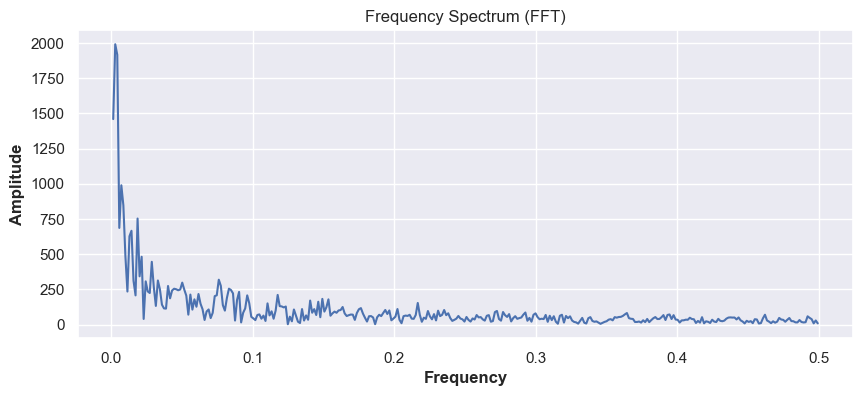

Dominant frequency: 0.00031191515907673113
Estimated period: 3206.0 points


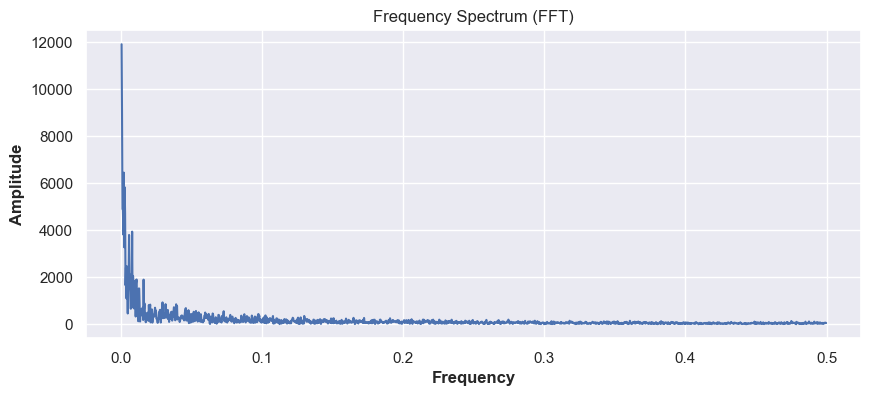

Dominant frequency: 0.0005640157924421884
Estimated period: 1773.0 points


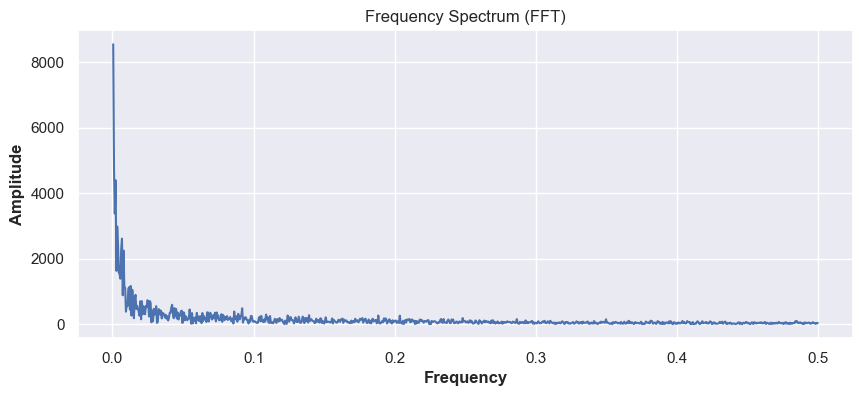

Dominant frequency: 0.0007564296520423601
Estimated period: 1322.0 points


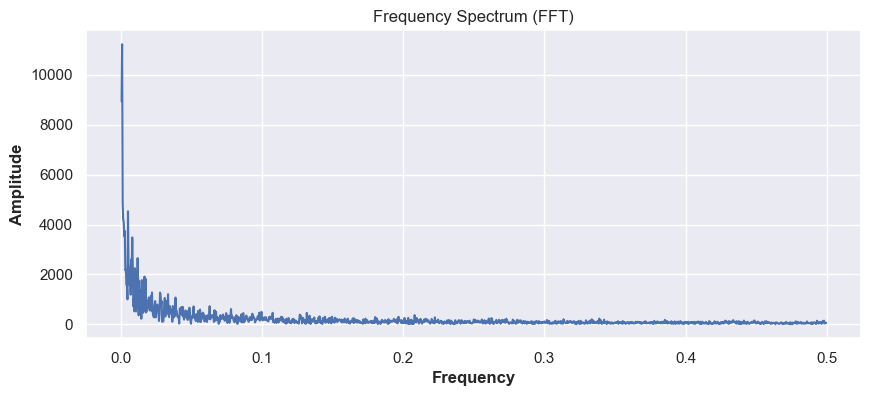

Dominant frequency: 0.00032268473701193933
Estimated period: 3099.0 points


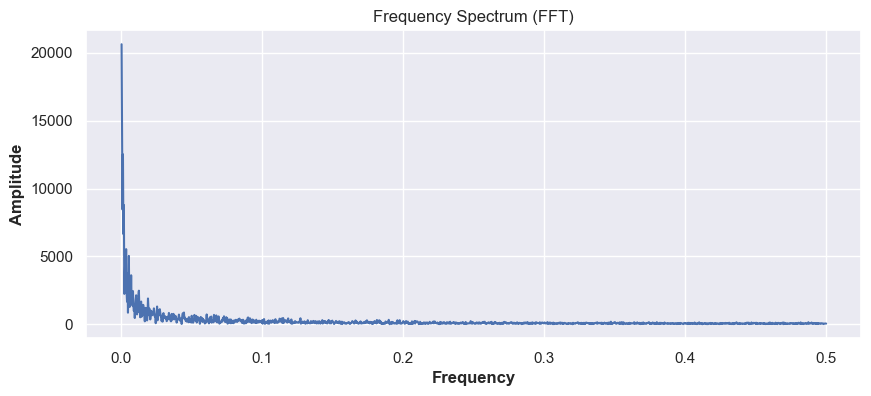

Dominant frequency: 0.0008012820512820513
Estimated period: 1248.0 points


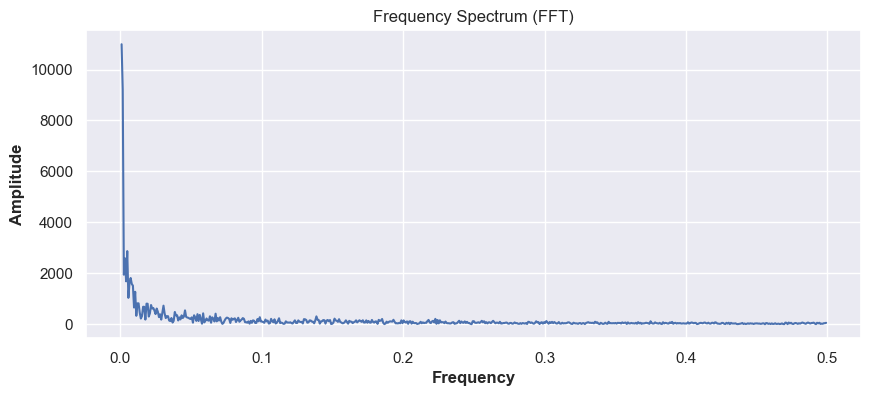

Dominant frequency: 0.0007209805335255948
Estimated period: 1387.0 points


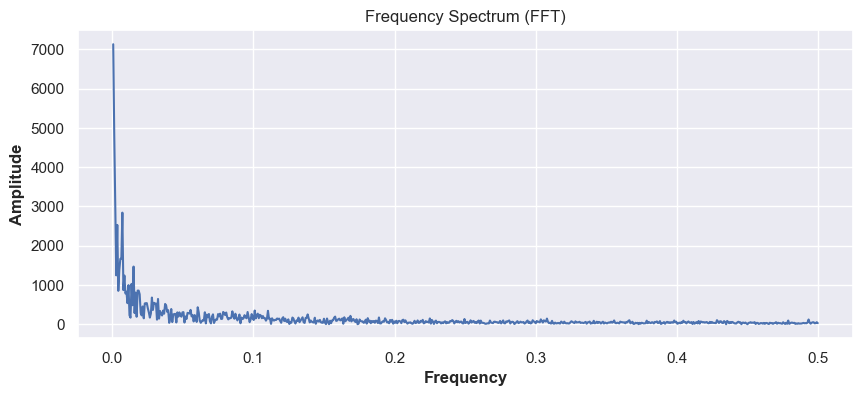

Dominant frequency: 0.00036563071297989033
Estimated period: 2735.0 points


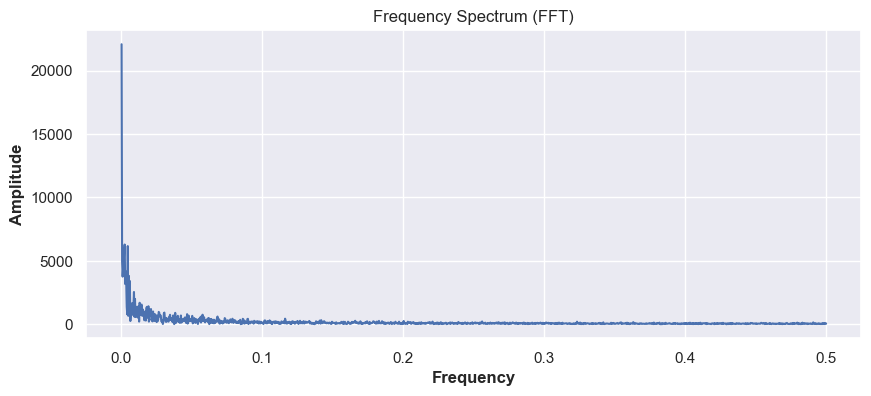

Dominant frequency: 0.0004880429477794046
Estimated period: 2049.0 points


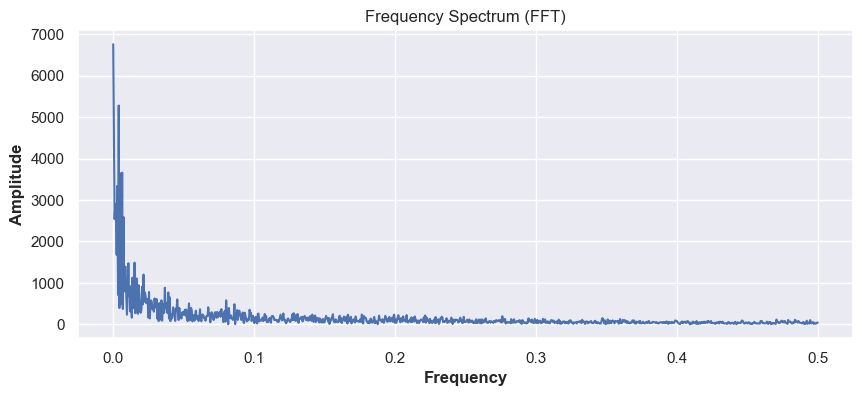

Dominant frequency: 0.00749063670411985
Estimated period: 133.5 points


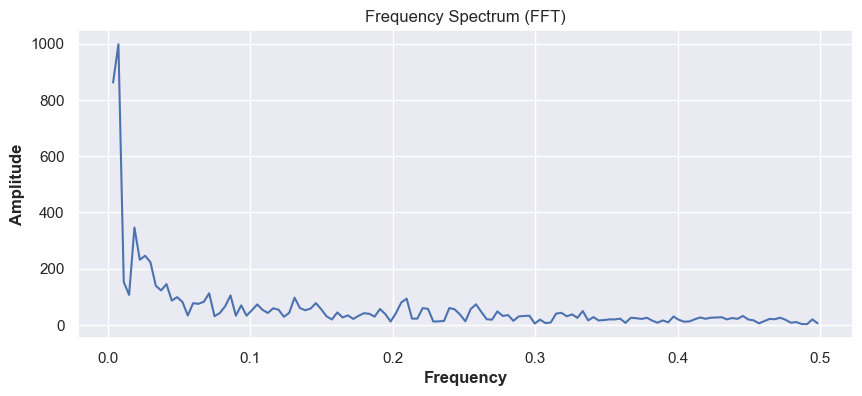

Dominant frequency: 0.0015220700152207
Estimated period: 657.0 points


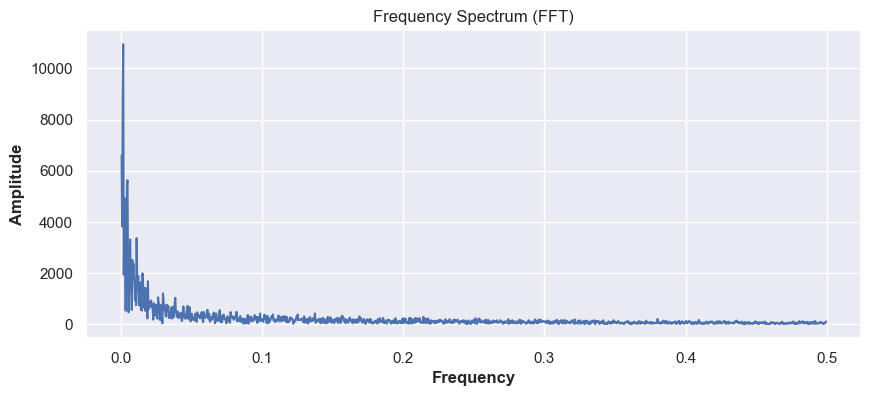

Dominant frequency: 0.0005128205128205128
Estimated period: 1950.0 points


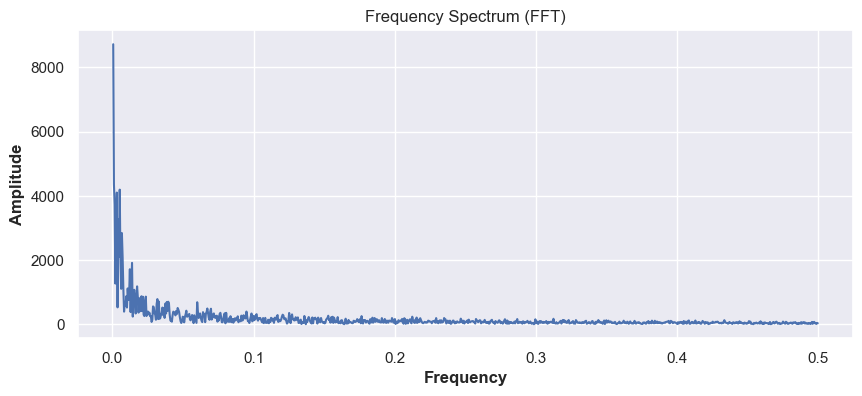

Dominant frequency: 0.00041893590280687055
Estimated period: 2387.0 points


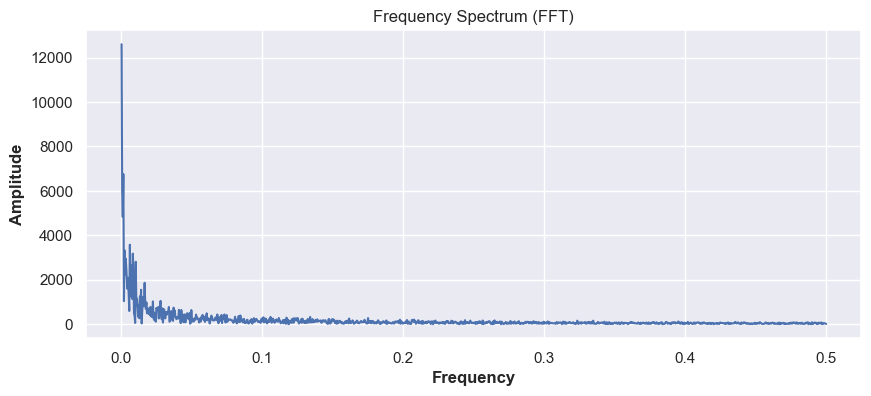

Dominant frequency: 0.0007852375343541421
Estimated period: 1273.5 points


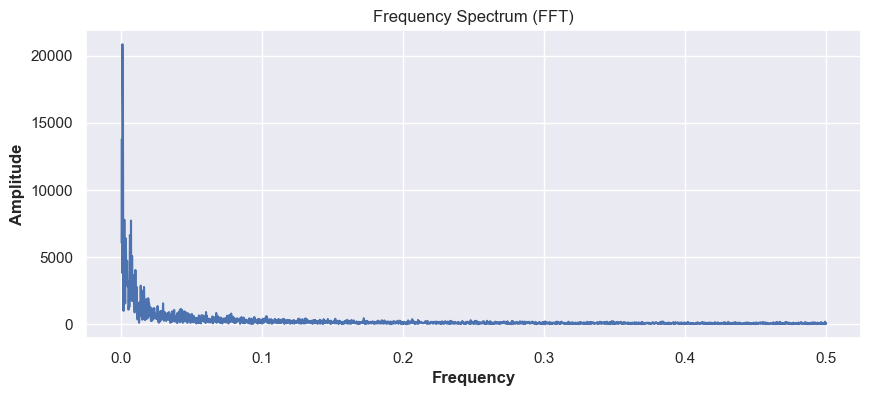

Dominant frequency: 0.002904162633107454
Estimated period: 344.3 points


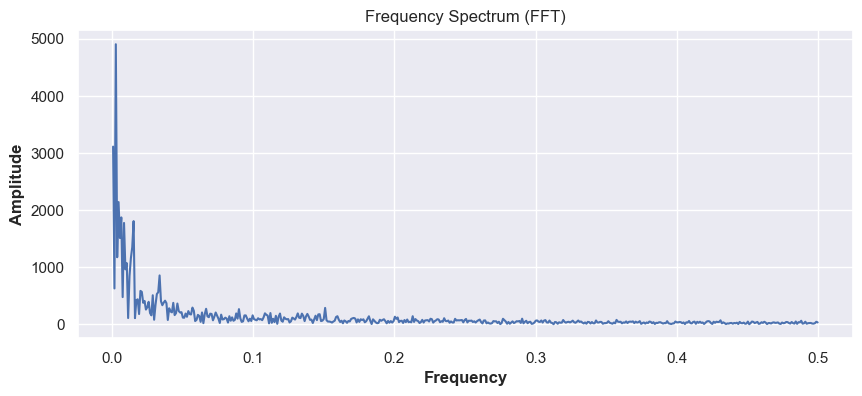

Dominant frequency: 0.001049317943336831
Estimated period: 953.0 points


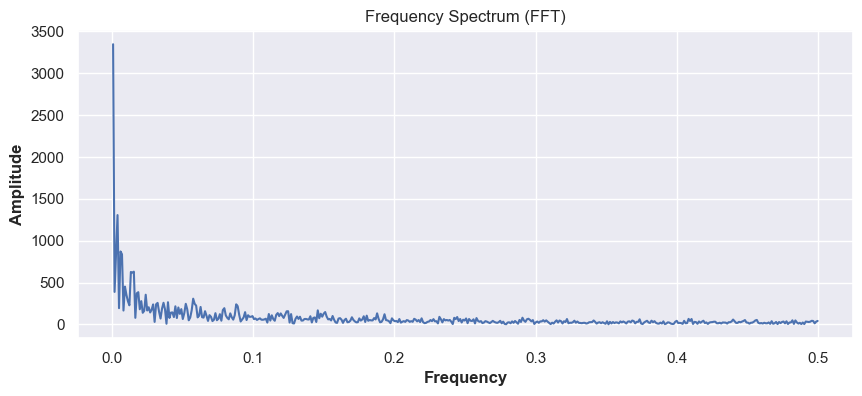

Dominant frequency: 0.0006079027355623101
Estimated period: 1645.0 points


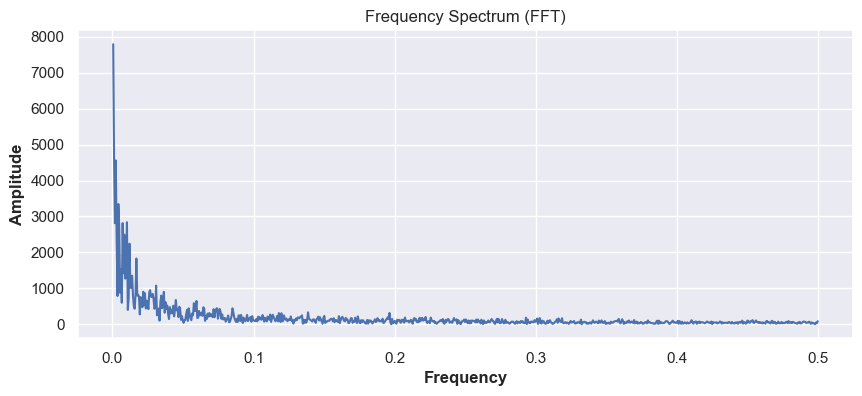

Dominant frequency: 0.00066711140760507
Estimated period: 1499.0 points


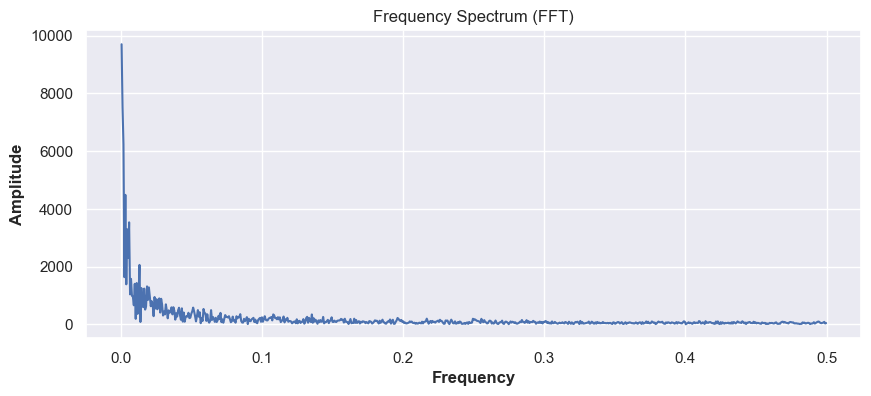

Dominant frequency: 0.002770083102493075
Estimated period: 361.0 points


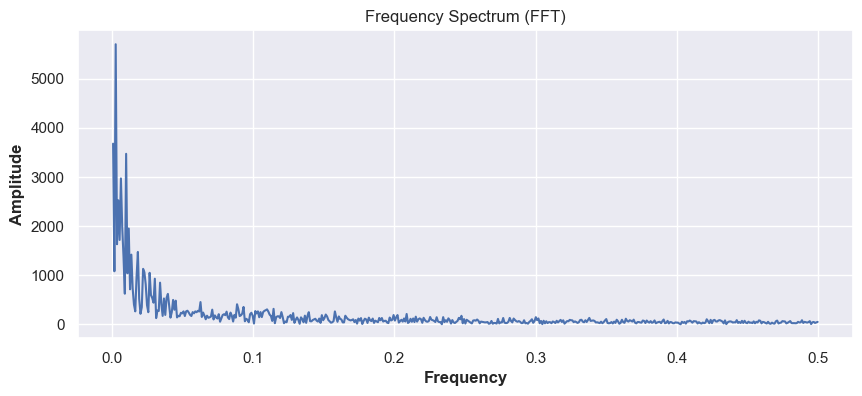

Dominant frequency: 0.0016366612111292963
Estimated period: 611.0 points


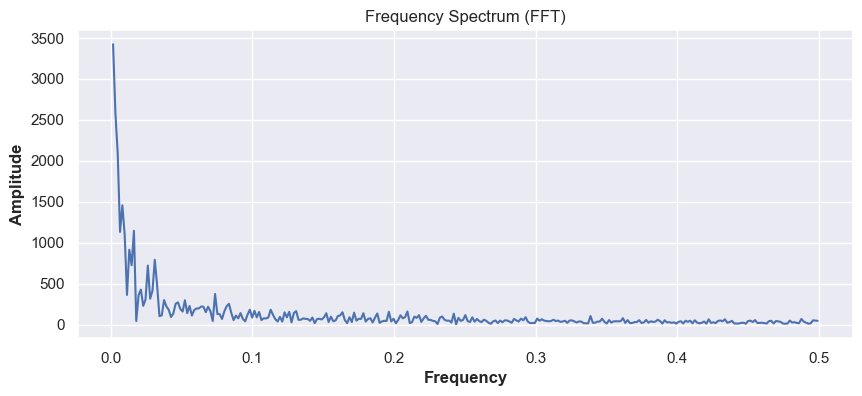

Dominant frequency: 0.0010141987829614604
Estimated period: 986.0 points


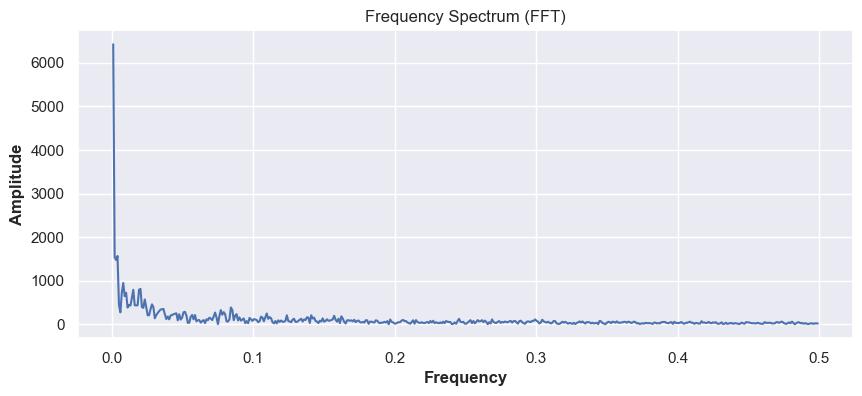

Dominant frequency: 0.0007396449704142012
Estimated period: 1352.0 points


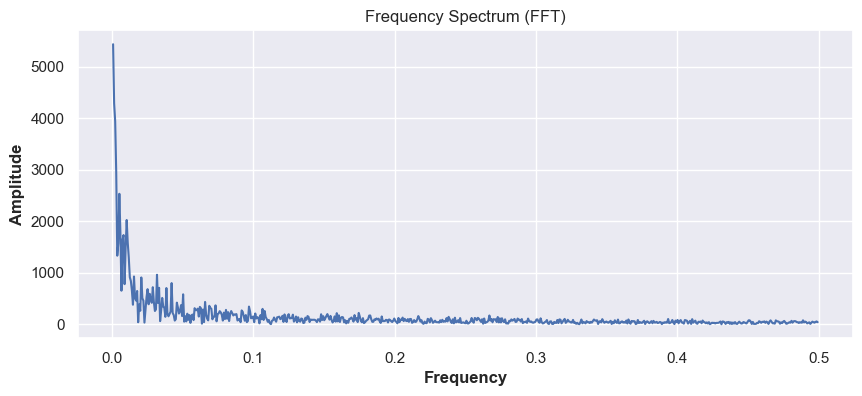

Dominant frequency: 0.0002600780234070221
Estimated period: 3845.0 points


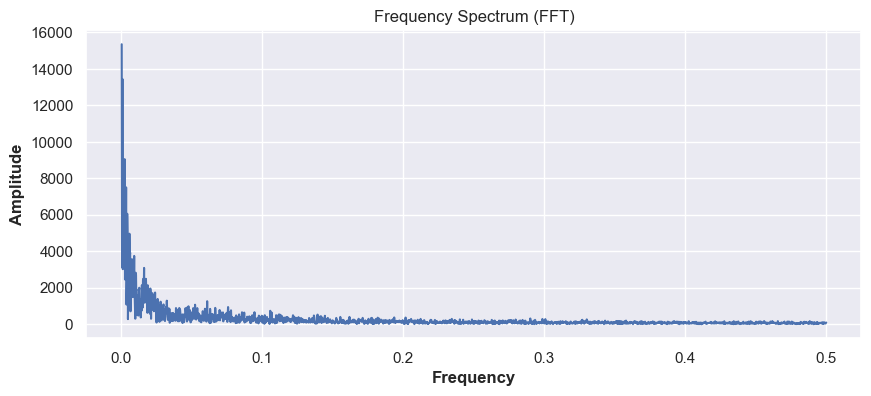

Dominant frequency: 0.0008250825082508251
Estimated period: 1212.0 points


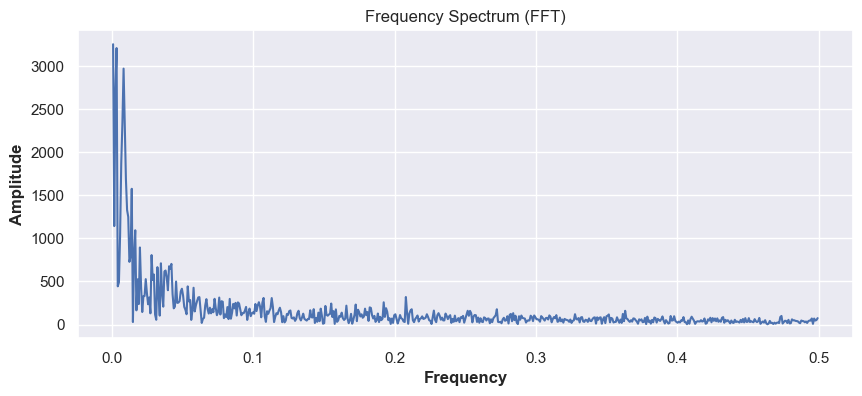

Dominant frequency: 0.0016116035455278
Estimated period: 620.5 points


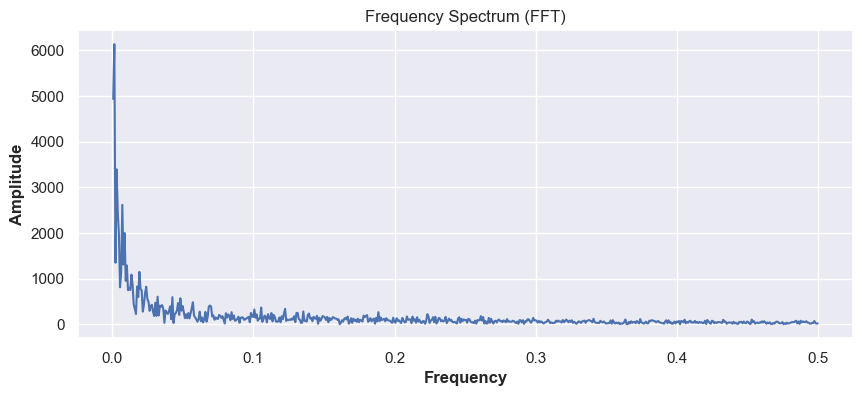

Dominant frequency: 0.00038226299694189603
Estimated period: 2616.0 points


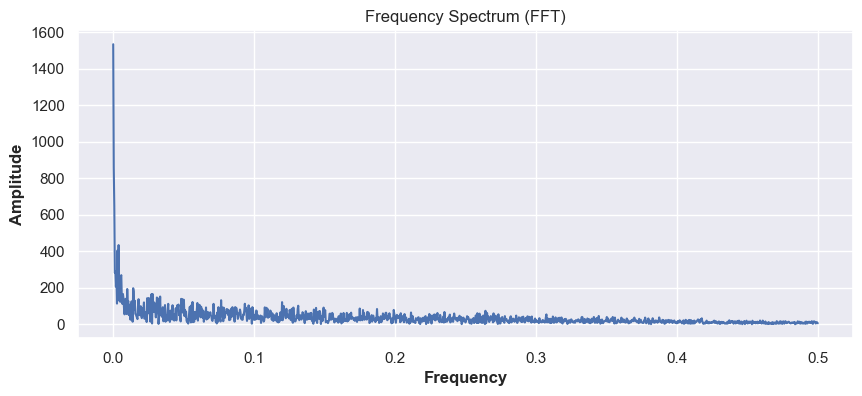

Dominant frequency: 0.0004508566275924256
Estimated period: 2218.0 points


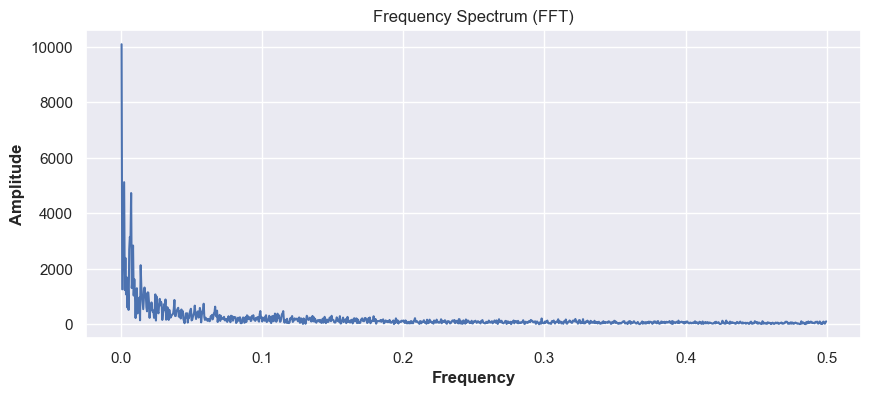

In [125]:
# Série em array
for serie in processed_series:
    detect_periodicity_fft(serie)

## Decomposição da Série Temporal

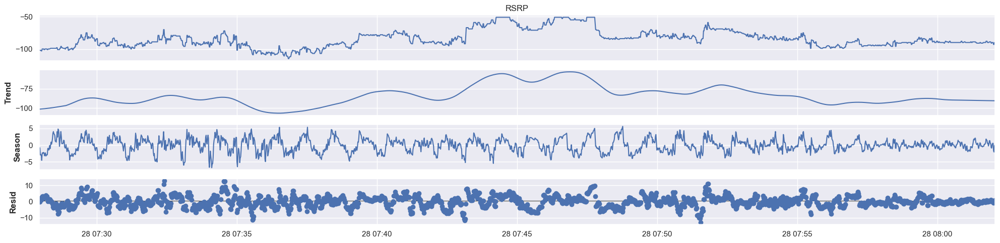

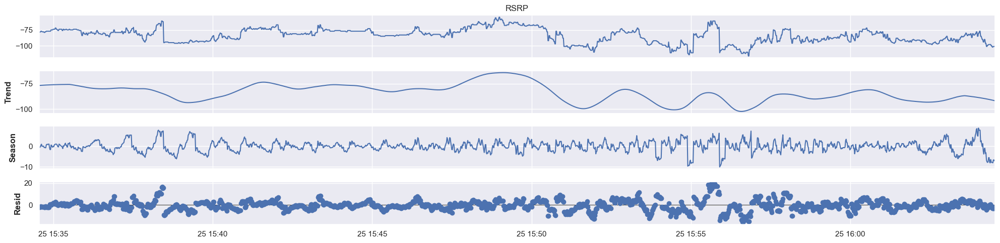

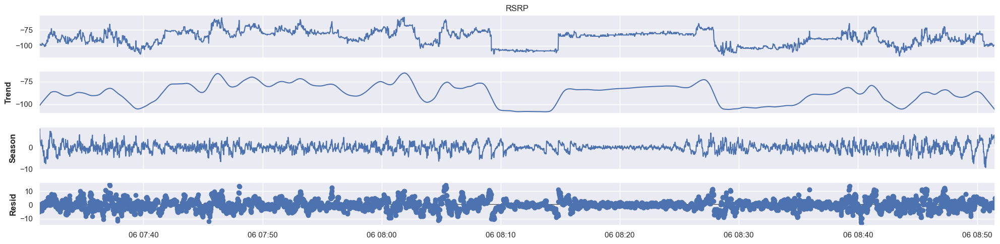

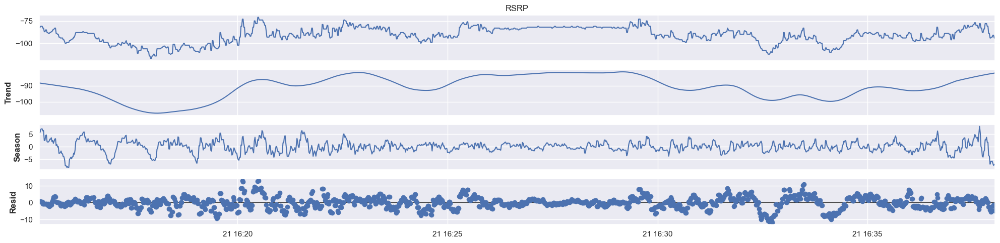

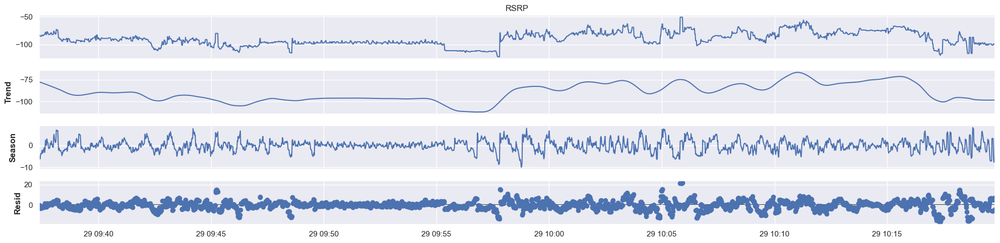

...

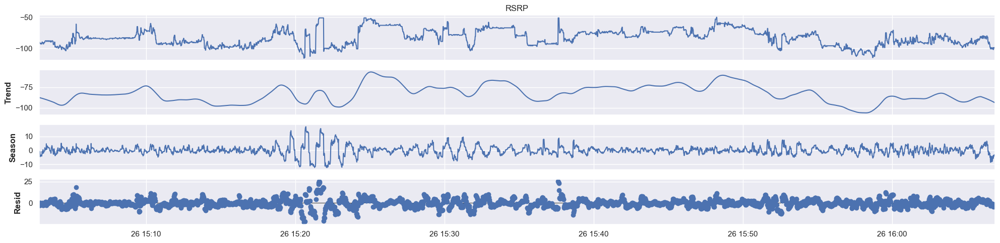

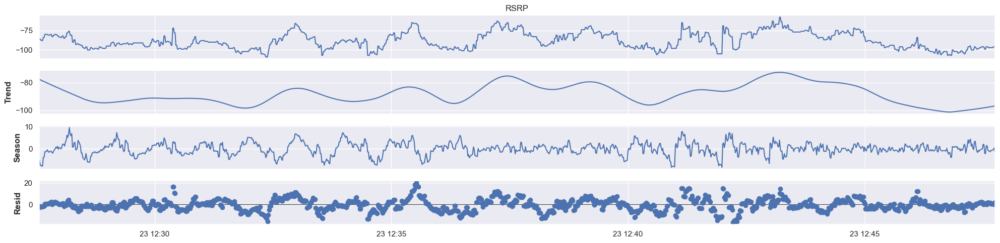

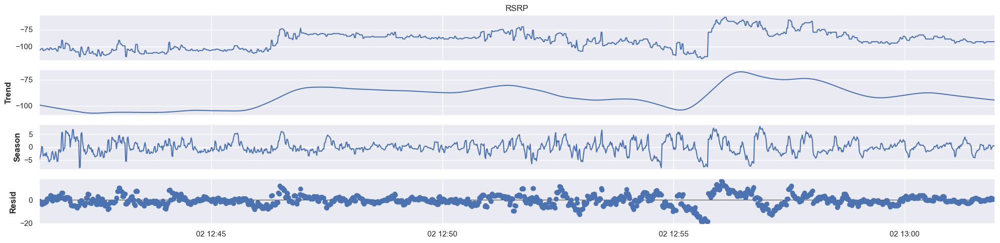

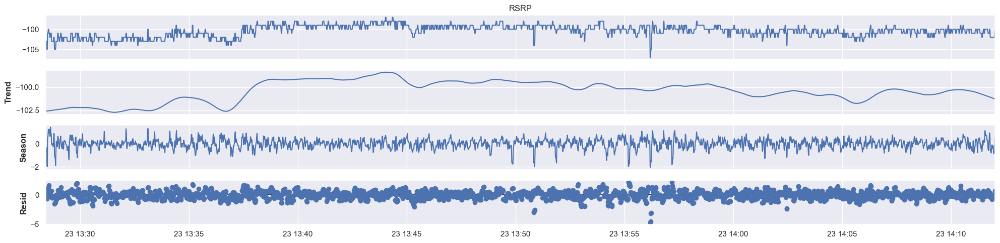

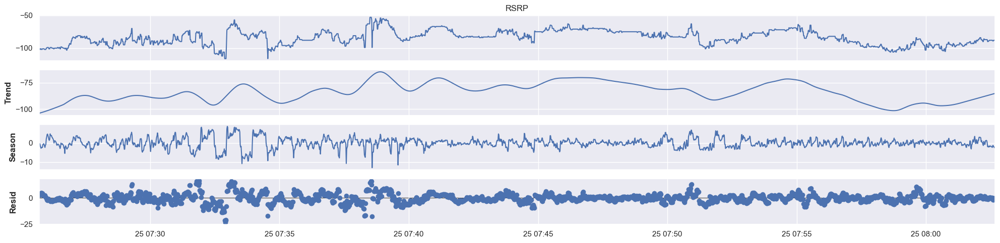

In [126]:
for serie in processed_series:
    stl = STL(serie.pd_series(), period=60)  # usa o período estimado
    result = stl.fit()
    result.plot();

# Treinando modelo

In [127]:
# Just checking
processed_series[0].pd_dataframe().isna().sum()

component
RSRP    0
dtype: int64

In [128]:
series = processed_series[0]
train, test = train_test_split(
    series, test_size=0.1, axis=1
)

<Axes: xlabel='time'>

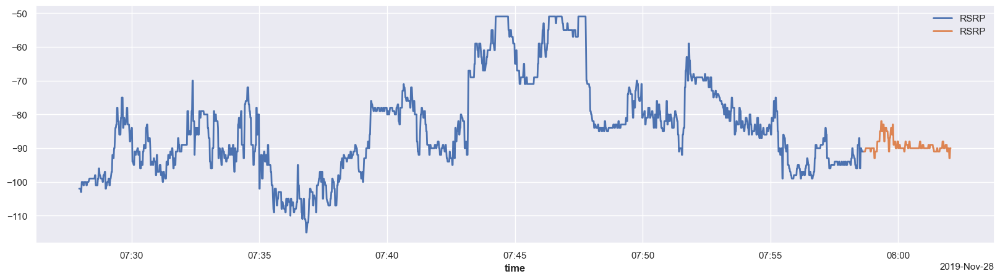

In [129]:
train.plot()
test.plot()

## Naive

In [130]:
series = processed_series[0]

historical forecasts:   0%|          | 0/81 [00:00<?, ?it/s]

MAE: 2.3950617283950617
RMSE: 3.5892500678251325
MAPE: 2.6245452765433237


<Axes: xlabel='time'>

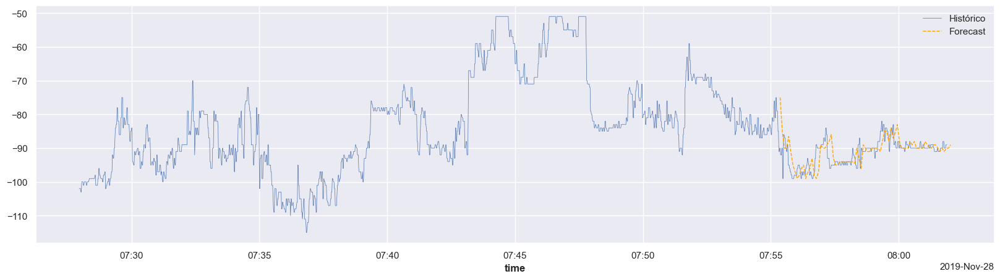

In [131]:
forecast_horizon = 10
stride = 5

naive_ma = NaiveMovingAverage()

forecast = naive_ma.historical_forecasts(
    series,
    start=0.8,             # ou uma timestamp, ou índice exato
    forecast_horizon=forecast_horizon,
    stride=stride,
    retrain=True,         # ou False, dependendo do modelo
    verbose=True
)

# Concatenar ao longo do tempo (eixo 0)
forecast_series = concatenate(forecast, axis=0)

# Interseção com ground truth
ground_truth = series.slice_intersect(forecast_series)

# Métricas
print("MAE:", mae(ground_truth, forecast_series))
print("RMSE:", rmse(ground_truth, forecast_series))
print("MAPE:", mape(ground_truth, forecast_series))

# Plot histórico
series[:-forecast_horizon].plot(label="Histórico", lw=0.5)

# # Plot Ground Truth (últimos forecast_horizon pontos reais)
# series[forecast_horizon:].plot(label="Ground Truth", lw=1, color="blue")

# Plot Forecast
forecast.plot(label="Forecast", lw=1, linestyle="--", color="orange")

## Exponential Smoothing

In [132]:
from darts.utils.utils import ModelMode, SeasonalityMode

### No Trend and No Seasonality

In [133]:
series = processed_series[0]

AIC: 2664.0851786947555
MAPE: 13.283865028697294
MAE: 12.259168763761124
RMSE: 12.830567927572316


<Axes: xlabel='time'>

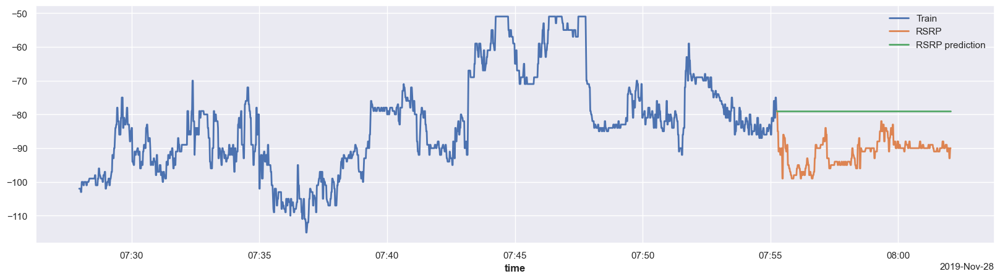

In [134]:
es_model = ExponentialSmoothing(seasonal=ModelMode.NONE, trend=SeasonalityMode.NONE)

train, test = train_test_split(
    series, test_size=0.2, axis=1
)
es_model.fit(train)
print(f"AIC: {es_model.model.aic}")
y_pred = es_model.predict(len(test)).with_columns_renamed("RSRP", "RSRP prediction")

print("MAPE:", mape(test, y_pred))
print("MAE:", mae(test, y_pred))
print("RMSE:", rmse(test, y_pred))

train.plot(label="Train")
test.plot()
y_pred.plot()

### Backtesting

In [135]:
series = processed_series[0]

In [136]:
forecast_horizon = 10
stride = 5

es_model = ExponentialSmoothing(seasonal=ModelMode.NONE, trend=SeasonalityMode.NONE)

forecast = es_model.historical_forecasts(
    series,
    start=0.8,             # ou uma timestamp, ou índice exato
    forecast_horizon=forecast_horizon,
    stride=stride,
    retrain=True,         # ou False, dependendo do modelo
    verbose=True
)

historical forecasts:   0%|          | 0/81 [00:00<?, ?it/s]

MAE: 2.395061710696253
RMSE: 3.589250053504972
MAPE: 2.6245452567631022


<Axes: xlabel='time'>

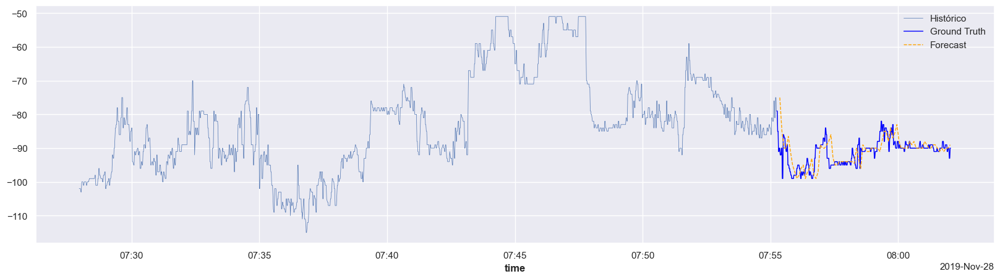

In [137]:
# Concatenar ao longo do tempo (eixo 0)
forecast_series = concatenate(forecast, axis=0)

# Interseção com ground truth
ground_truth = series.slice_intersect(forecast_series)

# Métricas
print("MAE:", mae(ground_truth, forecast_series))
print("RMSE:", rmse(ground_truth, forecast_series))
print("MAPE:", mape(ground_truth, forecast_series))

# Plot histórico
series[:-forecast_horizon].plot(label="Histórico", lw=0.5)

# Plot Ground Truth (últimos forecast_horizon pontos reais)
test.plot(label="Ground Truth", lw=1, color="blue")

# Plot Forecast
forecast.plot(label="Forecast", lw=1, linestyle="--", color="orange")

### With Trend and Seasonality

In [138]:
series = processed_series[0]

AIC: 2794.5914953871716
MAPE: 17.945779700455756
MAE: 16.486748560227714
RMSE: 16.919076910610656


<Axes: xlabel='time'>

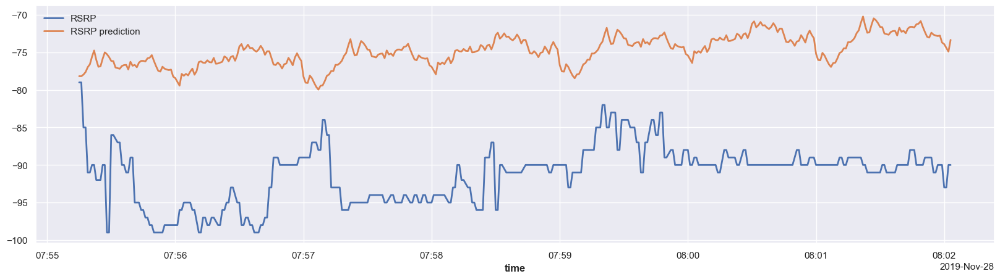

In [139]:
es_model = ExponentialSmoothing(seasonal=ModelMode.ADDITIVE, trend=SeasonalityMode.ADDITIVE, seasonal_periods=60*2)

train, test = train_test_split(
    series, test_size=0.2, axis=1
)
es_model.fit(train)
print(f"AIC: {es_model.model.aic}")
y_pred = es_model.predict(len(test)).with_columns_renamed("RSRP", "RSRP prediction")

print("MAPE:", mape(test, y_pred))
print("MAE:", mae(test, y_pred))
print("RMSE:", rmse(test, y_pred))

test.plot()
y_pred.plot()

### Only Seasonal Extracted by FFT

In [140]:
series = processed_series[0]
seasonal_periods=221

AIC: 2857.656759521025
MAPE: 14.055299133387308
MAE: 12.94808760035202
RMSE: 13.68918071996937


<Axes: xlabel='time'>

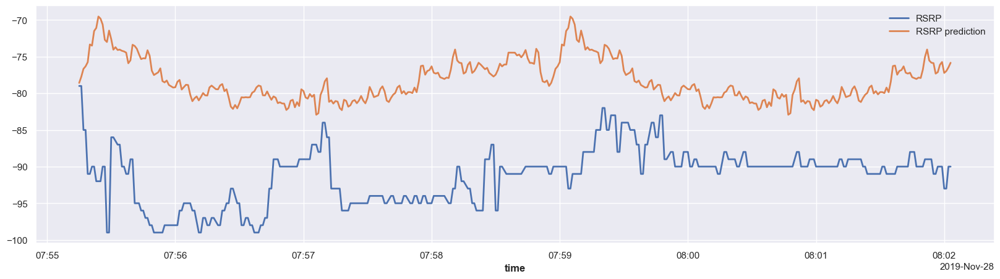

In [141]:
es_model = ExponentialSmoothing(
    seasonal=ModelMode.ADDITIVE, # experimente com "multiplicative" se fizer sentido
    trend=SeasonalityMode.NONE, 
    seasonal_periods=seasonal_periods # Período estimado pela FFT
    )

train, test = train_test_split(
    series, test_size=0.2, axis=1
)
es_model.fit(train)
print(f"AIC: {es_model.model.aic}")
y_pred = es_model.predict(len(test)).with_columns_renamed("RSRP", "RSRP prediction")

print("MAPE:", mape(test, y_pred))
print("MAE:", mae(test, y_pred))
print("RMSE:", rmse(test, y_pred))

test.plot()
y_pred.plot()

### Backtest: Only Seasonal Extracted by FFT

In [142]:
series = processed_series[0]
seasonal_periods=221
forecast_horizon = 10
stride = 5

es_model = ExponentialSmoothing(
    seasonal=ModelMode.ADDITIVE, # experimente com "multiplicative" se fizer sentido
    trend=SeasonalityMode.NONE, 
    seasonal_periods=221 # Período estimado pela FFT
    )

forecast = es_model.historical_forecasts(
    series,
    start=0.8,             # ou uma timestamp, ou índice exato
    forecast_horizon=forecast_horizon,
    stride=stride,
    retrain=True,         # ou False, dependendo do modelo
    verbose=True
)

historical forecasts:   0%|          | 0/81 [00:00<?, ?it/s]

MAE: 3.1154409583009772
RMSE: 4.607278800043602
MAPE: 3.4274407765013524


<Axes: xlabel='time'>

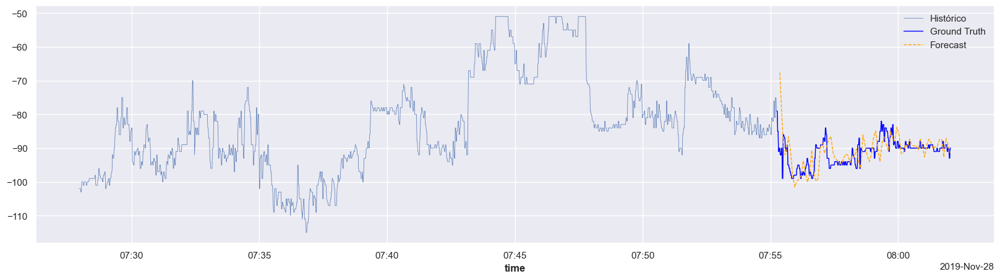

In [143]:
# Concatenar ao longo do tempo (eixo 0)
forecast_series = concatenate(forecast, axis=0)

# Interseção com ground truth
ground_truth = series.slice_intersect(forecast_series)

# Métricas
print("MAE:", mae(ground_truth, forecast_series))
print("RMSE:", rmse(ground_truth, forecast_series))
print("MAPE:", mape(ground_truth, forecast_series))

# Plot histórico
series[:-forecast_horizon].plot(label="Histórico", lw=0.5)

# Plot Ground Truth (últimos forecast_horizon pontos reais)
test.plot(label="Ground Truth", lw=1, color="blue")

# Plot Forecast
forecast.plot(label="Forecast", lw=1, linestyle="--", color="orange")

## AutoARIMA

### No Seasonal

In [144]:
series = processed_series[0]

In [145]:
auto_arima_model = AutoARIMA(seasonal=False, stepwise=True)

train, test = train_test_split(
    series, test_size=0.2, axis=1
)
auto_arima_model.fit(train)

AutoARIMA(add_encoders=None, seasonal=False, stepwise=True)

In [146]:
auto_arima_model.model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                 1638
Model:               SARIMAX(2, 1, 1)   Log Likelihood               -3615.661
Date:                Wed, 23 Apr 2025   AIC                           7239.322
Time:                        16:41:17   BIC                           7260.924
Sample:                             0   HQIC                          7247.334
                               - 1638                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3050      0.103      2.950      0.003       0.102       0.508
ar.L2         -0.2085      0.018    -11.795      0.000      -0.243      -0.174
ma.L1         -0.2280      0.102     -2.237      0.025      -0.428      -0.028
sigma2         4.8524      0.068     71.732      0.000       4.720       4.985
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):              9938.59
Prob(Q):                              1.00   Prob(JB):                         0.00
Heteroskedasticity (H):               0.54   Skew:                            -0.16
Prob(H) (two-sided):                  0.00   Kurtosis:                        15.07
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

MAPE: 13.61935033488311
MAE: 12.564747498862973
RMSE: 13.12250841942501


<Axes: xlabel='time'>

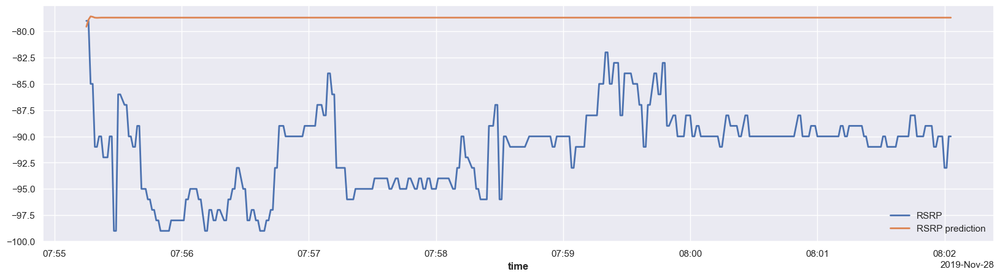

In [147]:
y_pred = auto_arima_model.predict(len(test)).with_columns_renamed("RSRP", "RSRP prediction")

print("MAPE:", mape(test, y_pred))
print("MAE:", mae(test, y_pred))
print("RMSE:", rmse(test, y_pred))

test.plot()
y_pred.plot()

### AutoARIMA Backtest

In [148]:
forecast_horizon = 10
stride = 5

auto_arima_model = AutoARIMA(seasonal=False)

forecast = auto_arima_model.historical_forecasts(
    series,
    start=0.8,             # ou uma timestamp, ou índice exato
    forecast_horizon=forecast_horizon,
    stride=stride,
    retrain=True,         # ou False, dependendo do modelo
    verbose=True
)

historical forecasts:   0%|          | 0/81 [00:00<?, ?it/s]

MAE: 2.340348589665953
RMSE: 3.530698203127186
MAPE: 2.5639583999073663


<Axes: xlabel='time'>

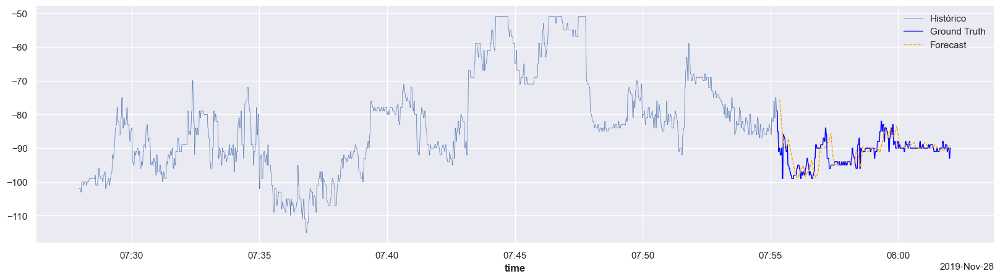

In [149]:
# Concatenar ao longo do tempo (eixo 0)
forecast_series = concatenate(forecast, axis=0)

# Interseção com ground truth
ground_truth = series.slice_intersect(forecast_series)

# Métricas
print("MAE:", mae(ground_truth, forecast_series))
print("RMSE:", rmse(ground_truth, forecast_series))
print("MAPE:", mape(ground_truth, forecast_series))

# Plot histórico
series[:-forecast_horizon].plot(label="Histórico", lw=0.5)

# Plot Ground Truth (últimos forecast_horizon pontos reais)
test.plot(label="Ground Truth", lw=1, color="blue")

# Plot Forecast
forecast.plot(label="Forecast", lw=1, linestyle="--", color="orange")

### Seasonal

In [150]:
auto_arima_model = AutoARIMA(seasonal=True)
series = processed_series[0]
train, test = train_test_split(
    series, test_size=0.2, axis=1
)
auto_arima_model.fit(train)

AutoARIMA(add_encoders=None, seasonal=True)

In [151]:
forecast_horizon = 10
stride = 5

auto_arima_model = AutoARIMA(seasonal=True)

forecast = auto_arima_model.historical_forecasts(
    series,
    start=0.8,             # ou uma timestamp, ou índice exato
    forecast_horizon=forecast_horizon,
    stride=stride,
    retrain=True,         # ou False, dependendo do modelo
    verbose=True
)

historical forecasts:   0%|          | 0/81 [00:00<?, ?it/s]

MAE: 2.340348589665953
RMSE: 3.530698203127186
MAPE: 2.5639583999073663


<Axes: xlabel='time'>

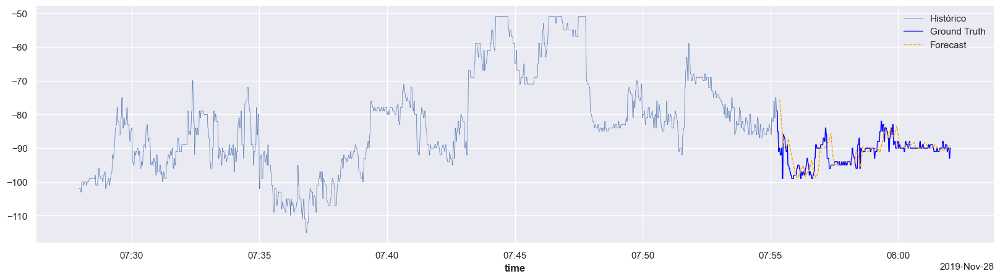

In [152]:
# Concatenar ao longo do tempo (eixo 0)
forecast_series = concatenate(forecast, axis=0)

# Interseção com ground truth
ground_truth = series.slice_intersect(forecast_series)

# Métricas
print("MAE:", mae(ground_truth, forecast_series))
print("RMSE:", rmse(ground_truth, forecast_series))
print("MAPE:", mape(ground_truth, forecast_series))

# Plot histórico
series[:-forecast_horizon].plot(label="Histórico", lw=0.5)

# Plot Ground Truth (últimos forecast_horizon pontos reais)
test.plot(label="Ground Truth", lw=1, color="blue")

# Plot Forecast
forecast.plot(label="Forecast", lw=1, linestyle="--", color="orange")

# Machine Learning Models

## Simple RNN

In [153]:
from darts.utils.likelihood_models import GaussianLikelihood

In [154]:
series = processed_series[0]

# Normalizar (recomendado)
scaler = Scaler()
series_scaled = scaler.fit_transform(series)

train, test = train_test_split(
    series_scaled, test_size=0.2, axis=1
)

# Modelo RNN (pode ser LSTM, GRU também)
model = RNNModel(
    model='GRU',
    input_chunk_length=30,
    output_chunk_length=10,
    hidden_dim=25,
    n_rnn_layers=1,
    training_length=60,
    dropout=0.0,
    batch_size=16,
    n_epochs=100,
    optimizer_kwargs={'lr': 1e-3},
    random_state=42,
    likelihood=GaussianLikelihood(),
    pl_trainer_kwargs={"accelerator": "cpu"},  # ou "cpu" se necessário
)

# Treinar modelo
model.fit(train, verbose=True)

ignoring user defined `output_chunk_length`. RNNModel uses a fixed `output_chunk_length=1`.


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs

  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | MSELoss          | 0      | train
1 | train_criterion | MSELoss          | 0      | train
2 | val_criterion   | MSELoss          | 0      | train
3 | train_metrics   | MetricCollection | 0      | train
4 | val_metrics     | MetricCollection | 0      | train
5 | rnn             | GRU              | 2.1 K  | train
6 | V               | Linear           | 52     | train
-------------------------------------------------------------
2.2 K     Trainable params
0         Non-trainable params
2.2 K     Total params
0.009     Total estimated model params size (MB)
7         Modules in train mode
0         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.


RNNModel(model=GRU, hidden_dim=25, n_rnn_layers=1, dropout=0.0, training_length=60, input_chunk_length=30, output_chunk_length=10, batch_size=16, n_epochs=100, optimizer_kwargs={'lr': 0.001}, random_state=42, likelihood=GaussianLikelihood(prior_mu=None, prior_sigma=None, prior_strength=1.0, beta_nll=0.0), pl_trainer_kwargs={'accelerator': 'cpu'})

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Predicting: |          | 0/? [00:00<?, ?it/s]

MAE: 32.474054144502375
RMSE: 35.42412038822832
MAPE: 35.706771664680225


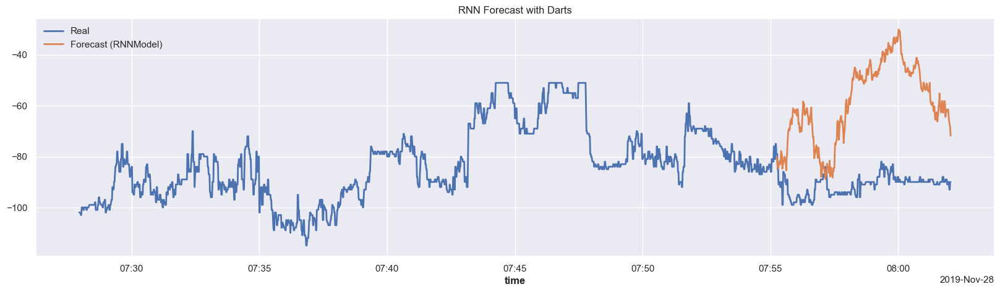

In [155]:
# Prever
forecast = model.predict(n=len(test))

# Inverter escala
test_back = scaler.inverse_transform(test)
forecast_back = scaler.inverse_transform(forecast)
series_back = scaler.inverse_transform(series_scaled)

# Métricas
print("MAE:", mae(test_back, forecast_back))
print("RMSE:", rmse(test_back, forecast_back))
print("MAPE:", mape(test_back, forecast_back))

# Visualização
series_back.plot(label="Real")
forecast_back.plot(label="Forecast (RNNModel)")
plt.title("RNN Forecast with Darts")
plt.legend()
plt.show()

### Teste com HMM (Hidden Markov Models)

In [156]:
from hmmlearn.hmm import GaussianHMM

In [157]:
# Série original (Darts TimeSeries)
series = processed_series[0]

In [158]:
# Normalizar para melhor estabilidade numérica
scaler = Scaler()
series_scaled = scaler.fit_transform(series)

# Converter para array
y = series_scaled.values().flatten().reshape(-1, 1)

# Definir e treinar HMM
n_states = 4  # número de estados ocultos
model = GaussianHMM(n_components=n_states, covariance_type="diag", n_iter=1000, random_state=42)
model.fit(y)

Model is not converging.  Current: 2693.490512205655 is not greater than 2693.5121386352203. Delta is -0.02162642956545824


GaussianHMM(n_components=4, n_iter=1000, random_state=42)

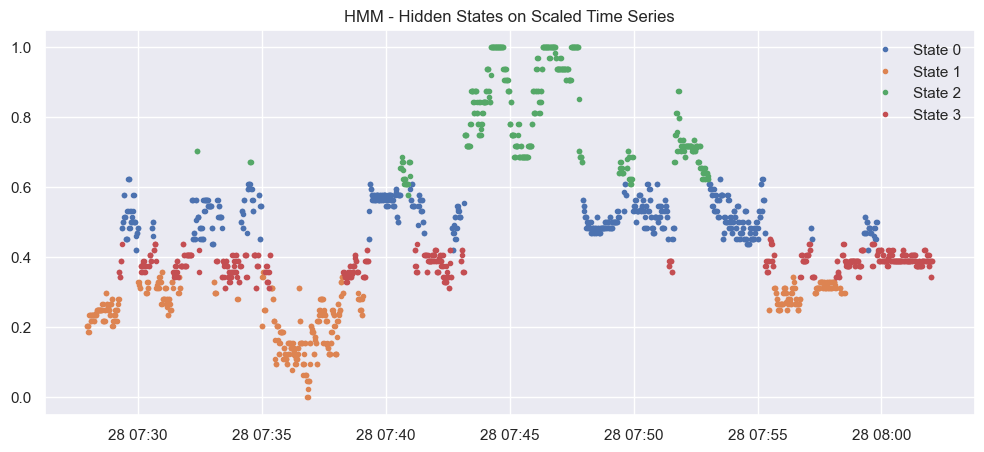

In [159]:
# Obter estados ocultos
hidden_states = model.predict(y)

# Plotar a série com os estados ocultos
plt.figure(figsize=(12, 5))
for i in range(n_states):
    mask = hidden_states == i
    plt.plot(series.time_index[mask], y[mask], '.', label=f"State {i}")
plt.title("HMM - Hidden States on Scaled Time Series")
plt.legend()
plt.show()

# Testes